In [1]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn import preprocessing

%matplotlib inline

In [2]:
df = pd.read_csv("311-DSNY-20151017.csv")
print(len(df))
df.head()

576487


,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Vehicle Type,Taxi Company Borough,Taxi Pick Up Location,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Latitude,Longitude,Location
0,29653961,01/07/2015 06:50:12 PM,NaN,DSNY,Department of Sanitation,Graffiti,Graffiti,NaN,NaN,10 s4 st,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,29655441,01/07/2015 08:17:00 AM,01/07/2015 12:00:00 PM,DSNY,BCC - Queens East,Snow,15S Re-Plow/Spread/Ice-Snow Cond.,Street,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,29750581,01/19/2015 05:00:00 PM,01/21/2015 12:00:00 PM,DSNY,BCC - Queens West,Litter Basket / Request,10 Litter Basket / Request,Sidewalk,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,29767423,01/22/2015 09:21:00 AM,01/31/2015 12:00:00 PM,DSNY,A - Canine Task Force Citywide,Dirty Conditions,E8 Canine Violation,Sidewalk,NaN,QUEENS BOULEVARD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,29618799,01/02/2015 06:11:00 AM,01/05/2015 12:00:00 PM,DSNY,Bronx 10,Sanitation Condition,12 Dead Animals,Sidewalk,NaN,HUTCHISON RIVER PKW,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
# Noted that in the dataset, 'Closed Date' should be target label, and for some rows like row 0, 
# they do not have string-formated 'Closed Date' values, so dive deep here to check whether they are all NaN
nan_df = df[np.array([type(item)!=str for item in df["Closed Date"].values])]

for item in nan_df["Closed Date"].values:
    if not np.isnan(item):
        print(type(item)) # All missing Closed Date values are float('nan')
        
df = df[np.array([type(item)==str for item in df["Closed Date"].values])] # We only take rows with valid Close Dates
print(len(df)) # 6245 rows sifted out
df.head()

570242


,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Vehicle Type,Taxi Company Borough,Taxi Pick Up Location,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Latitude,Longitude,Location
1,29655441,01/07/2015 08:17:00 AM,01/07/2015 12:00:00 PM,DSNY,BCC - Queens East,Snow,15S Re-Plow/Spread/Ice-Snow Cond.,Street,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,29750581,01/19/2015 05:00:00 PM,01/21/2015 12:00:00 PM,DSNY,BCC - Queens West,Litter Basket / Request,10 Litter Basket / Request,Sidewalk,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,29767423,01/22/2015 09:21:00 AM,01/31/2015 12:00:00 PM,DSNY,A - Canine Task Force Citywide,Dirty Conditions,E8 Canine Violation,Sidewalk,NaN,QUEENS BOULEVARD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,29618799,01/02/2015 06:11:00 AM,01/05/2015 12:00:00 PM,DSNY,Bronx 10,Sanitation Condition,12 Dead Animals,Sidewalk,NaN,HUTCHISON RIVER PKW,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,29618633,01/02/2015 09:57:00 AM,01/05/2015 12:00:00 PM,DSNY,Brooklyn North 03,Sweeping/Missed,3A Sweeping/Missed,Sidewalk,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Feature Engineering

In [4]:
df.columns

Index(['Unique Key', 'Created Date', 'Closed Date', 'Agency', 'Agency Name',
       'Complaint Type', 'Descriptor', 'Location Type', 'Incident Zip',
       'Incident Address', 'Street Name', 'Cross Street 1', 'Cross Street 2',
       'Intersection Street 1', 'Intersection Street 2', 'Address Type',
       'City', 'Landmark', 'Facility Type', 'Status', 'Due Date',
       'Resolution Description', 'Resolution Action Updated Date',
       'Community Board', 'BBL', 'Borough', 'X Coordinate (State Plane)',
       'Y Coordinate (State Plane)', 'Open Data Channel Type',
       'Park Facility Name', 'Park Borough', 'Vehicle Type',
       'Taxi Company Borough', 'Taxi Pick Up Location', 'Bridge Highway Name',
       'Bridge Highway Direction', 'Road Ramp', 'Bridge Highway Segment',
       'Latitude', 'Longitude', 'Location'],
      dtype='object')

In [5]:
# Do column features checking for nan values, some columns only have nan values which should not be considered as valid 
# data source for feature engineering.

not_nan_columns = []
for i in range(3, len(df.columns)):
    for value in df.iloc[:, i].values:
        if type(value) == str:
            print(df.columns[i], "string", value)
            not_nan_columns.append(df.columns[i])
            break
        if not math.isnan(value):
            print(df.columns[i], value)
            not_nan_columns.append(df.columns[i])
            break
            
nan_columns = [col for col in df.columns if col not in not_nan_columns][3:]
nan_columns

Agency string DSNY
Agency Name string BCC - Queens East
Complaint Type string Snow
Descriptor string 15S Re-Plow/Spread/Ice-Snow Cond.
Location Type string Street
Incident Zip 11212.0
Incident Address string QUEENS BOULEVARD
Street Name string QUEENS BOULEVARD
Cross Street 1 string 83 STREET
Cross Street 2 string VAN WYCK EXPRESSWAY
Intersection Street 1 string 106 AVENUE
Intersection Street 2 string 217 STREET
Address Type string INTERSECTION
City string BROOKLYN
Facility Type string DSNY Garage
Status string Closed
Due Date string 06/27/2015 10:29:08 AM
Resolution Description string The Department of Sanitation investigated this complaint and salted the area.
Resolution Action Updated Date string 01/07/2015 12:00:00 PM
Community Board string 13 QUEENS
BBL 4035650020.0
Borough string QUEENS
X Coordinate (State Plane) 1031816.0
Y Coordinate (State Plane) 236058.0
Open Data Channel Type string PHONE
Park Facility Name string Unspecified
Park Borough string QUEENS
Latitude 40.81447236364

['Landmark',
 'Vehicle Type',
 'Taxi Company Borough',
 'Taxi Pick Up Location',
 'Bridge Highway Name',
 'Bridge Highway Direction',
 'Road Ramp',
 'Bridge Highway Segment']

In [6]:
# Double check to discard all those columns/features that only contain nan values:

for col in nan_columns:
    print(sum(np.isnan(df[col].values)))
    
for col in nan_columns:
    df.drop(col, axis=1, inplace=True)

570242
570242
570242
570242
570242
570242
570242
570242


## Remove uselss features:

In [7]:
# Remove Agency column from candidate features because it provides no useful information:
print(sum(df["Agency"].values=="DSNY"))
df.drop('Agency', axis=1, inplace=True)

570242


In [8]:
# Facility Type:
print(np.unique(df['Facility Type'].values.astype(str)))
df.drop('Facility Type', axis=1, inplace=True)

['DSNY Garage' 'nan']


In [9]:
# Most of the Resolution Action Update Date == Closed Date, drop
print(sum(df['Resolution Action Updated Date'] == df['Closed Date'])/len(df))
df.drop('Resolution Action Updated Date', axis=1, inplace=True)

0.9050087506707678


In [10]:
# Highlt relevant with Complaint Type, only 'Graffiti' has a 'not-nan' value in Due Date column:
print(np.unique(df["Complaint Type"][np.where(df["Due Date"].values.astype(str)=="nan",False, True)]))
# Another column to drop: Due Date, intuitively from data dictionary to eda results
df.drop('Due Date', axis=1, inplace=True)

['Graffiti']


In [11]:
hhx_df = df[np.where(df["Park Borough"].values.astype(str) == "nan", False, True)]
print(sum(hhx_df["Park Borough"] == hhx_df['Borough']), len(hhx_df))
df.drop("Park Borough", axis=1, inplace=True)

568654 568654


In [12]:
df.head()
# After sifting out Nan values filled columns, I will start feature engineering by diving deeper into 
# data within each columns

,Unique Key,Created Date,Closed Date,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,Street Name,...,Community Board,BBL,Borough,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type,Park Facility Name,Latitude,Longitude,Location
1,29655441,01/07/2015 08:17:00 AM,01/07/2015 12:00:00 PM,BCC - Queens East,Snow,15S Re-Plow/Spread/Ice-Snow Cond.,Street,NaN,NaN,NaN,...,13 QUEENS,NaN,QUEENS,NaN,NaN,PHONE,Unspecified,NaN,NaN,NaN
2,29750581,01/19/2015 05:00:00 PM,01/21/2015 12:00:00 PM,BCC - Queens West,Litter Basket / Request,10 Litter Basket / Request,Sidewalk,NaN,NaN,NaN,...,05 QUEENS,NaN,QUEENS,NaN,NaN,PHONE,Unspecified,NaN,NaN,NaN
3,29767423,01/22/2015 09:21:00 AM,01/31/2015 12:00:00 PM,A - Canine Task Force Citywide,Dirty Conditions,E8 Canine Violation,Sidewalk,NaN,QUEENS BOULEVARD,QUEENS BOULEVARD,...,09 QUEENS,NaN,QUEENS,NaN,NaN,ONLINE,Unspecified,NaN,NaN,NaN
4,29618799,01/02/2015 06:11:00 AM,01/05/2015 12:00:00 PM,Bronx 10,Sanitation Condition,12 Dead Animals,Sidewalk,NaN,HUTCHISON RIVER PKW,HUTCHISON RIVER PKW,...,10 BRONX,NaN,BRONX,NaN,NaN,PHONE,Unspecified,NaN,NaN,NaN
5,29618633,01/02/2015 09:57:00 AM,01/05/2015 12:00:00 PM,Brooklyn North 03,Sweeping/Missed,3A Sweeping/Missed,Sidewalk,NaN,NaN,NaN,...,03 BROOKLYN,NaN,BROOKLYN,NaN,NaN,PHONE,Unspecified,NaN,NaN,NaN


## More on EDA:

### Categorical geo info:

In [13]:
np.unique(df["Borough"].values.astype(str))

array(['BRONX', 'BROOKLYN', 'MANHATTAN', 'QUEENS', 'STATEN ISLAND',
       'Unspecified', 'nan'], dtype='<U13')

In [14]:
np.unique(df['City'].values.astype(str))

array(['Arverne', 'Astoria', 'BRONX', 'BROOKLYN', 'Bayside', 'Bellerose',
       'Breezy Point', 'Cambria Heights', 'College Point', 'Corona',
       'East Elmhurst', 'Elmhurst', 'Far Rockaway', 'Floral Park',
       'Flushing', 'Forest Hills', 'Fresh Meadows', 'Glen Oaks', 'Hollis',
       'Howard Beach', 'Jackson Heights', 'Jamaica', 'Kew Gardens',
       'Little Neck', 'Long Island City', 'Maspeth', 'Middle Village',
       'NEW YORK', 'New Hyde Park', 'Oakland Gardens', 'Ozone Park',
       'QUEENS', 'Queens Village', 'Rego Park', 'Richmond Hill',
       'Ridgewood', 'Rockaway Park', 'Rosedale', 'STATEN ISLAND',
       'Saint Albans', 'South Ozone Park', 'South Richmond Hill',
       'Springfield Gardens', 'Sunnyside', 'Whitestone', 'Woodhaven',
       'Woodside', 'nan'], dtype='<U19')

In [15]:
np.unique(df["Community Board"].values.astype(str)) # should be highly relevant with Borough column

array(['0 Unspecified', '01 BRONX', '01 BROOKLYN', '01 MANHATTAN',
       '01 QUEENS', '01 STATEN ISLAND', '02 BRONX', '02 BROOKLYN',
       '02 MANHATTAN', '02 QUEENS', '02 STATEN ISLAND', '03 BRONX',
       '03 BROOKLYN', '03 MANHATTAN', '03 QUEENS', '03 STATEN ISLAND',
       '04 BRONX', '04 BROOKLYN', '04 MANHATTAN', '04 QUEENS', '05 BRONX',
       '05 BROOKLYN', '05 MANHATTAN', '05 QUEENS', '06 BRONX',
       '06 BROOKLYN', '06 MANHATTAN', '06 QUEENS', '07 BRONX',
       '07 BROOKLYN', '07 MANHATTAN', '07 QUEENS', '08 BRONX',
       '08 BROOKLYN', '08 MANHATTAN', '08 QUEENS', '09 BRONX',
       '09 BROOKLYN', '09 MANHATTAN', '09 QUEENS', '10 BRONX',
       '10 BROOKLYN', '10 MANHATTAN', '10 QUEENS', '11 BRONX',
       '11 BROOKLYN', '11 MANHATTAN', '11 QUEENS', '12 BRONX',
       '12 BROOKLYN', '12 MANHATTAN', '12 QUEENS', '13 BROOKLYN',
       '13 QUEENS', '14 BROOKLYN', '14 QUEENS', '15 BROOKLYN',
       '16 BROOKLYN', '17 BROOKLYN', '18 BROOKLYN', '26 BRONX',
       '27 BRONX',

(array([3.00000e+01, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 4.96100e+04,
        1.00000e+00, 1.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 4.85350e+04,
        0.00000e+00, 4.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 3.64860e+04, 1.31391e+05,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 6.11650e+04, 7.47010e+04,
        1.45500e+03, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 5.31080e+04, 1.00000e+00]),
 array([0.000000e+00, 1.040030e+08, 2.080060e+08, 3.120090e+08,
        4.160120e+08, 5.200150e+08, 6.240180e+08, 7.280210e+08,
        8.320240e+08, 9.360270e+08, 1.040030e+09, 1.144033e+09,
        1.248036e+09, 1.352039e+09, 1.456042e+09, 1.560045e+09,
        1.66

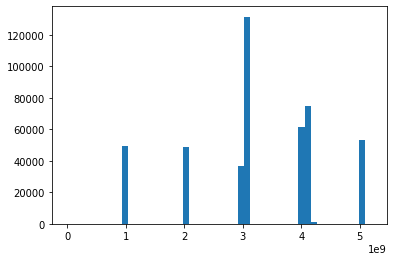

In [16]:
plt.hist(df["BBL"].values, bins=50) 
# From observation, we can tell that BBL should be a perfect categorical feature for our district geo features,
# It is highly relevant with City, Borough, Comunity Board, and it is a higher level of classification standards.

In [17]:
df_gb = df.loc[:, ["BBL", "City", "Borough", "Community Board"]].groupby("BBL")
for key, value in df_gb:
    print(df_gb.get_group(key))
# Further display the correlation between those 4 features indicating that BBL should be a sub category derived from
# Borough, Community Board and City, taking a very long time, don't run it!!

        BBL      City    Borough Community Board
11520   0.0  BROOKLYN   BROOKLYN     12 BROOKLYN
18491   0.0  BROOKLYN   BROOKLYN     06 BROOKLYN
38040   0.0  BROOKLYN   BROOKLYN     04 BROOKLYN
41066   0.0  BROOKLYN   BROOKLYN     04 BROOKLYN
47729   0.0     BRONX      BRONX        04 BRONX
52503   0.0    Corona     QUEENS       04 QUEENS
73136   0.0     BRONX      BRONX        04 BRONX
76106   0.0  BROOKLYN   BROOKLYN     15 BROOKLYN
76150   0.0  BROOKLYN   BROOKLYN     15 BROOKLYN
80107   0.0  BROOKLYN   BROOKLYN     03 BROOKLYN
156378  0.0  BROOKLYN   BROOKLYN     13 BROOKLYN
193319  0.0  BROOKLYN   BROOKLYN     13 BROOKLYN
201630  0.0  BROOKLYN   BROOKLYN     13 BROOKLYN
208669  0.0  BROOKLYN   BROOKLYN     08 BROOKLYN
226501  0.0  BROOKLYN   BROOKLYN     04 BROOKLYN
240310  0.0   Astoria     QUEENS       01 QUEENS
256170  0.0  NEW YORK  MANHATTAN    09 MANHATTAN
297761  0.0  BROOKLYN   BROOKLYN     06 BROOKLYN
334214  0.0  BROOKLYN   BROOKLYN     04 BROOKLYN
349070  0.0  BROOKLY

386572  1.000300e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
376271  1.000300e+09  NEW YORK  MANHATTAN    01 MANHATTAN
386787  1.000300e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
19865   1.000310e+09  NEW YORK  MANHATTAN    01 MANHATTAN
312909  1.000310e+09  NEW YORK  MANHATTAN    01 MANHATTAN
549419  1.000310e+09  NEW YORK  MANHATTAN    01 MANHATTAN
553402  1.000310e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
321224  1.000310e+09  NEW YORK  MANHATTAN    01 MANHATTAN
444255  1.000310e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
9587    1.000318e+09  NEW YORK  MANHATTAN    01 MANHATTAN
335624  1.000318e+09  NEW YORK  MANHATTAN    01 MANHATTAN
384601  1.000318e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
236063  1.0003

525387  1.000760e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
114693  1.000760e+09  NEW YORK  MANHATTAN    01 MANHATTAN
263176  1.000760e+09  NEW YORK  MANHATTAN    01 MANHATTAN
274835  1.000760e+09  NEW YORK  MANHATTAN    01 MANHATTAN
349599  1.000760e+09  NEW YORK  MANHATTAN    01 MANHATTAN
456622  1.000760e+09  NEW YORK  MANHATTAN    01 MANHATTAN
514222  1.000760e+09  NEW YORK  MANHATTAN    01 MANHATTAN
515360  1.000760e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
174428  1.000768e+09  NEW YORK  MANHATTAN    01 MANHATTAN
227805  1.000768e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
339304  1.000768e+09  NEW YORK  MANHATTAN    01 MANHATTAN
463463  1.000768e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
302365  1.000770e+09  NEW YORK  MANHATTAN    01 MANHATTAN
              

431781  1.001160e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
181174  1.001160e+09  NEW YORK  MANHATTAN    03 MANHATTAN
185283  1.001160e+09  NEW YORK  MANHATTAN    03 MANHATTAN
185363  1.001160e+09  NEW YORK  MANHATTAN    03 MANHATTAN
187639  1.001160e+09  NEW YORK  MANHATTAN    03 MANHATTAN
195915  1.001160e+09  NEW YORK  MANHATTAN    03 MANHATTAN
195942  1.001160e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
246525  1.001190e+09  NEW YORK  MANHATTAN    01 MANHATTAN
249275  1.001190e+09  NEW YORK  MANHATTAN    01 MANHATTAN
294297  1.001190e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
56742   1.001210e+09  NEW YORK  MANHATTAN    01 MANHATTAN
56877   1.001210e+09  NEW YORK  MANHATTAN    01 MANHATTAN
67846   1.001210e+09  NEW YORK  MANHATTAN    01 MANHATTAN
255061  1.001210e+09  NEW YORK  MANHATTAN    01 MANHATTAN
375169  1.0012

162083  1.001448e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
298171  1.001448e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
108754  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
169702  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
218291  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
576061  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
443908  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
451775  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
149416  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
185940  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
349479  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
349673  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
571288  1.001450e+09  NEW YORK  MANHATTAN    01 MANHATTAN
              

560156  1.001700e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
270153  1.001700e+09  NEW YORK  MANHATTAN    01 MANHATTAN
520060  1.001700e+09  NEW YORK  MANHATTAN    01 MANHATTAN
521347  1.001700e+09  NEW YORK  MANHATTAN    01 MANHATTAN
523592  1.001700e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
521647  1.001710e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
154627  1.001710e+09  NEW YORK  MANHATTAN    01 MANHATTAN
154960  1.001710e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
502136  1.001718e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
252913  1.001720e+09  NEW YORK  MANHATTAN    01 MANHATTAN
528004  1.001720e+09  NEW YORK  MANHATTAN    01 MANHATTAN
528644  1.001720e+09  NEW YORK  MANHATTAN    01 MANHATTAN
530752  1.0017

518650  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
160605  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
110622  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
132739  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
149597  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
149778  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
335451  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
105739  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
314231  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
335456  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
162720  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
165239  1.001890e+09  NEW YORK  MANHATTAN    01 MANHATTAN
              

391490  1.002000e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
461007  1.002000e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
460951  1.002000e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
116772  1.002000e+09  NEW YORK  MANHATTAN    03 MANHATTAN
161145  1.002000e+09  NEW YORK  MANHATTAN    03 MANHATTAN
239354  1.002000e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
245011  1.002000e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
135628  1.002000e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
335309  1.002000e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
191477  1.002008e+09  NEW YORK  MANHATTAN    03 MANHATTAN
210346  1.0020

379393  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
262143  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
262364  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
212052  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
355906  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
358260  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
363831  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
411417  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
412244  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
                 BBL      City    Borough Community Board
523846  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
552592  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
552845  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
553499  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
570073  1.002140e+09  NEW YORK  MANHATTAN    01 MANHATTAN
              

390369  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
98706   1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
138555  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
419499  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
428270  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
476129  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
338382  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
240303  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
272869  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
482266  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
482946  1.002300e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
206704  1.0023

341661  1.002390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
207105  1.002390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
282130  1.002390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
287966  1.002390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
293363  1.002390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
351588  1.002390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
393170  1.002390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
108201  1.002398e+09  NEW YORK  MANHATTAN    02 MANHATTAN
133138  1.002398e+09  NEW YORK  MANHATTAN    02 MANHATTAN
257064  1.002398e+09  NEW YORK  MANHATTAN    02 MANHATTAN
257286  1.002398e+09  NEW YORK  MANHATTAN    02 MANHATTAN
258836  1.002398e+09  NEW YORK  MANHATTAN    02 MANHATTAN
304866  1.002398e+09  NEW YORK  MANHATTAN    02 MANHATTAN
314555  1.002398e+09  NEW YORK  MANHATTAN    02 MANHATTAN
316437  1.002398e+09  NEW YORK  MANHATTAN    02 MANHATTAN
322711  1.0023

461077  1.002760e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
461089  1.002760e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
436966  1.002760e+09  NEW YORK  MANHATTAN    03 MANHATTAN
438781  1.002760e+09  NEW YORK  MANHATTAN    03 MANHATTAN
461057  1.002760e+09  NEW YORK  MANHATTAN    03 MANHATTAN
463427  1.002760e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
210129  1.002760e+09  NEW YORK  MANHATTAN    03 MANHATTAN
210263  1.002760e+09  NEW YORK  MANHATTAN    03 MANHATTAN
305818  1.002760e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
353523  1.002768e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
461043  1.002770e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
238927  1.0027

461004  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
11129   1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
396469  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
407014  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
425557  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
434433  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
460909  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
299555  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
410917  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
130375  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
177450  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
211600  1.002820e+09  NEW YORK  MANHATTAN    03 MANHATTAN
343735  1.0028

190875  1.002920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
309602  1.002920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
337349  1.002920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
110336  1.002928e+09  NEW YORK  MANHATTAN    03 MANHATTAN
210080  1.002928e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
152758  1.002930e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
211657  1.002930e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
392884  1.002930e+09  NEW YORK  MANHATTAN    03 MANHATTAN
395358  1.002930e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
106945  1.002930e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
166873  1.0029

486746  1.003038e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
185851  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
187857  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
193261  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
195825  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
230848  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
312848  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
324818  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
357379  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
396324  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
306775  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
106051  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
152983  1.003040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
567205  1.0030

441695  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
130932  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
141053  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
185563  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
215385  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
246031  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
255143  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
340330  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
369122  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
369415  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
386262  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
401991  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
436300  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
507885  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
112829  1.003110e+09  NEW YORK  MANHATTAN    03 MANHATTAN
114471  1.0031

469506  1.003480e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough        Community Board
6805    1.003480e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
121940  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
213764  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
260765  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
268173  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
351466  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
432250  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
464706  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
481905  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
503039  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
506258  1.003480e+09  NEW YORK  MANHATTAN           03 MANHATTAN
                 BBL      City    Borough Community Board
116991  1.003480e+09  NEW YORK  MANHATTAN    03 MANHATTAN
163859  1.003480e+09  NEW YORK  MANHATTAN    0

404236  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
109588  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
239192  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
239610  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
275539  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
287414  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
331077  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
384582  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
411255  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
411471  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
412835  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                BBL      City    Borough Community Board
87409  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
446362  1.003540e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                

417624  1.003750e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
551988  1.003750e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
58594   1.003750e+09  NEW YORK  MANHATTAN    03 MANHATTAN
413454  1.003750e+09  NEW YORK  MANHATTAN    03 MANHATTAN
428438  1.003750e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                BBL      City    Borough Community Board
44749  1.003750e+09  NEW YORK  MANHATTAN    03 MANHATTAN
67743  1.003750e+09  NEW YORK  MANHATTAN    03 MANHATTAN
67925  1.003750e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
207066  1.003758e+09  NEW YORK  MANHATTAN    03 MANHATTAN
361930  1.003758e+09  NEW YORK  MANHATTAN    03 MANHATTAN
364494  1.003758e+09  NEW YORK  MANHATTAN    03 MANHATTAN
546303  1.003758e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
240583  1.003758e+

293574  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
180057  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
460942  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
8004    1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
395627  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
117181  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
353244  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
455064  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
442772  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
536056  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
571612  1.003848e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
179499  1.003850e+09  NEW YORK  MANHATTAN    03 MANHATTAN
211112  1.0038

559350  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
559037  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
497654  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
252578  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
564358  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
567827  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
416340  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
422169  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
304943  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
416547  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
422296  1.003920e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
271824  1.0039

211001  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
299197  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
375606  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
538955  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
16913   1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
260331  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
353555  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
157130  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
249710  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
506417  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
569055  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
157680  1.003980e+09  NEW YORK  MANHATTAN    03 MANHATTAN
              

363563  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
437336  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
549794  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
183896  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
239087  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
347042  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
380435  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
537112  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
564775  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
568661  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
163755  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
238909  1.004040e+09  NEW YORK  MANHATTAN    03 MANHATTAN
347200  1.0040

396482  1.004080e+09  NEW YORK  MANHATTAN           03 MANHATTAN
                 BBL      City    Borough Community Board
390766  1.004080e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
262259  1.004080e+09  NEW YORK  MANHATTAN    03 MANHATTAN
394579  1.004080e+09  NEW YORK  MANHATTAN    03 MANHATTAN
396430  1.004080e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
213362  1.004080e+09  NEW YORK  MANHATTAN    03 MANHATTAN
280674  1.004080e+09  NEW YORK  MANHATTAN    03 MANHATTAN
482745  1.004080e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough        Community Board
7245    1.004088e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
108522  1.004088e+09  NEW YORK  MANHATTAN           03 MANHATTAN
223301  1.004088e+09  NEW YORK  MANHATTAN           03 MANHATTAN
255313  1.004088e+09  NEW YORK  MANHATTAN           03 MANHATTAN
396429  1.004088e+09  NEW YORK

531986  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
532507  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
533082  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
251729  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
407071  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
469340  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
560950  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
166209  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
453729  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
564262  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
106094  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
137676  1.004120e+09  NEW YORK  MANHATTAN    03 MANHATTAN
              

355462  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
115470  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
170728  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
190220  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
230837  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
379875  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
464835  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
555951  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
564360  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
113729  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
199134  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
432614  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
166204  1.004150e+09  NEW YORK  MANHATTAN    03 MANHATTAN
167944  1.0041

541626  1.004210e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough        Community Board
6925    1.004210e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
151694  1.004210e+09  NEW YORK  MANHATTAN           03 MANHATTAN
190700  1.004210e+09  NEW YORK  MANHATTAN           03 MANHATTAN
237671  1.004210e+09  NEW YORK  MANHATTAN           03 MANHATTAN
                 BBL      City    Borough Community Board
451447  1.004218e+09  NEW YORK  MANHATTAN    03 MANHATTAN
532284  1.004218e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
161884  1.004218e+09  NEW YORK  MANHATTAN    03 MANHATTAN
174230  1.004218e+09  NEW YORK  MANHATTAN    03 MANHATTAN
185273  1.004218e+09  NEW YORK  MANHATTAN    03 MANHATTAN
247027  1.004218e+09  NEW YORK  MANHATTAN    03 MANHATTAN
281599  1.004218e+09  NEW YORK  MANHATTAN    03 MANHATTAN
307571  1.004218e+09  NEW YORK  MANHATTAN    03 MANHATTAN
353543  1.004218e+09  NEW YORK  MANHA

431963  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
349614  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
238030  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
461013  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
460977  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
502917  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
142152  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
299119  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
299466  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
299597  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
299600  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
562301  1.004290e+09  NEW YORK  MANHATTAN    03 MANHATTAN
              

558564  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
150925  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
187273  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
515395  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                BBL      City    Borough Community Board
81711  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
110272  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
509832  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
243473  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
293540  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
423912  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
515196  1.004360e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
179995  1.004360

171368  1.004400e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
113178  1.004400e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
225409  1.004408e+09  NEW YORK  MANHATTAN    03 MANHATTAN
339678  1.004408e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
206336  1.004408e+09  NEW YORK  MANHATTAN    03 MANHATTAN
358724  1.004408e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
475387  1.004408e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
482305  1.004408e+09  NEW YORK  MANHATTAN    03 MANHATTAN
482629  1.004408e+09  NEW YORK  MANHATTAN    03 MANHATTAN
483417  1.004408e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
161869  1.004410e+09  NEW YORK  MANHATTAN    03 MANHATTAN
196506  1.0044

388753  1.004468e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
482294  1.004470e+09  NEW YORK  MANHATTAN    03 MANHATTAN
491564  1.004470e+09  NEW YORK  MANHATTAN    03 MANHATTAN
506367  1.004470e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
154271  1.004470e+09  NEW YORK  MANHATTAN    03 MANHATTAN
439015  1.004470e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
318414  1.004470e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
151391  1.004470e+09  NEW YORK  MANHATTAN    03 MANHATTAN
209753  1.004470e+09  NEW YORK  MANHATTAN    03 MANHATTAN
285174  1.004470e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough        Community Board
7529    1.004470e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
258166  1.004470e+09  NEW YORK  MANHATTAN           03 MAN

261922  1.004498e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
147732  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
387166  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
408892  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
203401  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
274754  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
234062  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
300692  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
566588  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
546768  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
410559  1.004500e+09  NEW YORK  MANHATTAN    03 MANHATTAN
493665  1.0045

427931  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
171507  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
200627  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
238189  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
257129  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
280723  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
281396  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
281864  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
282375  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
427036  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
427809  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
442017  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
543759  1.004550e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
305401  1.004560e+09  NEW YORK  MANHATTAN    03 MANHATTAN
461897  1.004560e+09  NEW YORK  MANHATTAN    03 MANHATTAN
              

346611  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
181494  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
372946  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
448111  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
218632  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
533697  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
371091  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
408387  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
409013  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
                 BBL      City    Borough Community Board
446271  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
454884  1.004640e+09  NEW YORK  MANHATTAN    03 MANHATTAN
              

484358  1.004700e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
495194  1.004700e+09  NEW YORK  MANHATTAN    02 MANHATTAN
560036  1.004700e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
106116  1.004708e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
532045  1.004710e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
174634  1.004710e+09  NEW YORK  MANHATTAN    02 MANHATTAN
314899  1.004710e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
368715  1.004710e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
333261  1.004710e+09  NEW YORK  MANHATTAN    02 MANHATTAN
334564  1.004710e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
109477  1.0047

197286  1.004778e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
461312  1.004778e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
224465  1.004780e+09  NEW YORK  MANHATTAN    02 MANHATTAN
226127  1.004780e+09  NEW YORK  MANHATTAN    02 MANHATTAN
237701  1.004780e+09  NEW YORK  MANHATTAN    02 MANHATTAN
395169  1.004780e+09  NEW YORK  MANHATTAN    02 MANHATTAN
511698  1.004780e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
391653  1.004780e+09  NEW YORK  MANHATTAN    02 MANHATTAN
405621  1.004780e+09  NEW YORK  MANHATTAN    02 MANHATTAN
497798  1.004780e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough        Community Board
7042    1.004780e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
148338  1.004780e+09  NEW YORK  MANHATTAN           02 MANHATTAN
250313  1.004780e+09  NEW YORK  MANHATTAN          

525519  1.004848e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
134351  1.004850e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
329699  1.004850e+09  NEW YORK  MANHATTAN    02 MANHATTAN
569400  1.004850e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
410283  1.004850e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
359168  1.004850e+09  NEW YORK  MANHATTAN    02 MANHATTAN
515529  1.004850e+09  NEW YORK  MANHATTAN    02 MANHATTAN
547179  1.004850e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
393660  1.004850e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
575524  1.004850e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
128499  1.0048

557901  1.004920e+09  NEW YORK  MANHATTAN           02 MANHATTAN
                 BBL      City    Borough Community Board
162057  1.004920e+09  NEW YORK  MANHATTAN    02 MANHATTAN
434974  1.004920e+09  NEW YORK  MANHATTAN    02 MANHATTAN
490873  1.004920e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
134065  1.004928e+09  NEW YORK  MANHATTAN    02 MANHATTAN
185210  1.004928e+09  NEW YORK  MANHATTAN    02 MANHATTAN
466925  1.004928e+09  NEW YORK  MANHATTAN    02 MANHATTAN
526434  1.004928e+09  NEW YORK  MANHATTAN    02 MANHATTAN
552470  1.004928e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
278520  1.004928e+09  NEW YORK  MANHATTAN    02 MANHATTAN
279038  1.004928e+09  NEW YORK  MANHATTAN    02 MANHATTAN
279221  1.004928e+09  NEW YORK  MANHATTAN    02 MANHATTAN
279298  1.004928e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
437497 

431481  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
572957  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
573144  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
106782  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
248522  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
492945  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
158083  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
192638  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
220807  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
224530  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
112106  1.005020e+09  NEW YORK  MANHATTAN    02 MANHATTAN
195568  1.0050

334132  1.005090e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
15383   1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
158332  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
187348  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
263791  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
272115  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
278176  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
290666  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
294711  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
309338  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
309586  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
348709  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
420448  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
425918  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
492400  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
545497  1.005100e+09  NEW YORK  MANHATTAN    02 MANHATTAN
              

461923  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
150798  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
251176  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
473839  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
316538  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
352391  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
389506  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
213690  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
138382  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
463092  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
500293  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
546426  1.005210e+09  NEW YORK  MANHATTAN    02 MANHATTAN
547193  1.0052

515105  1.005270e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
275029  1.005270e+09  NEW YORK  MANHATTAN    02 MANHATTAN
399940  1.005270e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
545078  1.005270e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
434094  1.005270e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
506640  1.005270e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
124171  1.005270e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
422050  1.005270e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
453107  1.005270e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
225844  1.0052

270454  1.005378e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
400715  1.005388e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
389319  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
113252  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
156787  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
192967  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
195959  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
198670  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
200493  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
203144  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
205427  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
206070  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
206072  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
213635  1.005390e+09  NEW YORK  MANHATTAN    02 MANHATTAN
216889  1.0053

476412  1.005488e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
451253  1.005500e+09  NEW YORK  MANHATTAN    02 MANHATTAN
453223  1.005500e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
346541  1.005500e+09  NEW YORK  MANHATTAN    02 MANHATTAN
346902  1.005500e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
467637  1.005500e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
124669  1.005510e+09  NEW YORK  MANHATTAN    02 MANHATTAN
480804  1.005510e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
305221  1.005510e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
134219  1.005510e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
470487  1.0055

508516  1.005628e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
219906  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
147142  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
203458  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
204789  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
206267  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
206694  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
207613  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
129018  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
353006  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
279234  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
299801  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
301833  1.005630e+09  NEW YORK  MANHATTAN    02 MANHATTAN
365356  1.0056

                 BBL      City    Borough Community Board
142446  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
206326  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
359412  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
361099  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
211210  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
165547  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
323547  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
528224  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
359076  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
170641  1.005720e+09  NEW YORK  MANHATTAN    02 MANHATTAN
              

367076  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
207826  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
209718  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
522422  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
291579  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
490039  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
400955  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
490675  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
145132  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
158475  1.005830e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
10276   1.0058

406720  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
271508  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
294304  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
428991  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
170376  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
301606  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
329053  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
538208  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
224239  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
263541  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
377377  1.005880e+09  NEW YORK  MANHATTAN    02 MANHATTAN
431358  1.0058

448706  1.005930e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
312899  1.005930e+09  NEW YORK  MANHATTAN    02 MANHATTAN
324301  1.005930e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
208504  1.005938e+09  NEW YORK  MANHATTAN    02 MANHATTAN
413340  1.005938e+09  NEW YORK  MANHATTAN    02 MANHATTAN
559216  1.005938e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
354139  1.005940e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
336649  1.005940e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
538504  1.005940e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
514793  1.005940e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
267344  1.0059

219474  1.006080e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
253515  1.006080e+09  NEW YORK  MANHATTAN    02 MANHATTAN
292131  1.006080e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
43524   1.006080e+09  NEW YORK  MANHATTAN    02 MANHATTAN
524624  1.006080e+09  NEW YORK  MANHATTAN    02 MANHATTAN
561885  1.006080e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
227707  1.006080e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
217121  1.006088e+09  NEW YORK  MANHATTAN    02 MANHATTAN
230591  1.006088e+09  NEW YORK  MANHATTAN    02 MANHATTAN
317821  1.006088e+09  NEW YORK  MANHATTAN    02 MANHATTAN
371760  1.006088e+09  NEW YORK  MANHATTAN    02 MANHATTAN
452422  1.006088e+09  NEW YORK  MANHATTAN    02 MANHATTAN
454203  1.006088e+09  NEW YORK  MANHATTAN    02 MANHATTAN
492775  1.0060

274037  1.006130e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
340877  1.006130e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
261984  1.006130e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
179760  1.006130e+09  NEW YORK  MANHATTAN    02 MANHATTAN
187592  1.006130e+09  NEW YORK  MANHATTAN    02 MANHATTAN
190273  1.006130e+09  NEW YORK  MANHATTAN    02 MANHATTAN
227685  1.006130e+09  NEW YORK  MANHATTAN    02 MANHATTAN
229618  1.006130e+09  NEW YORK  MANHATTAN    02 MANHATTAN
456826  1.006130e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough        Community Board
7508    1.006130e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
412390  1.006130e+09  NEW YORK  MANHATTAN           02 MANHATTAN
412434  1.006130e+09  NEW YORK  MANHATTAN           02 MANHATTAN
                 BBL      City    Borough Co

436406  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
260229  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
431225  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
206912  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
197482  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
173549  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
149165  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
167315  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
191111  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
220535  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
254759  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
272673  1.006190e+09  NEW YORK  MANHATTAN    02 MANHATTAN
318538  1.0061

448858  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
437344  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
198250  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
483432  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
132077  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
271177  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
442660  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
468688  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
492422  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
209965  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
210102  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
357210  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
511700  1.006250e+09  NEW YORK  MANHATTAN    02 MANHATTAN
              

                 BBL      City    Borough Community Board
149256  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
189502  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
227258  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
564815  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
573666  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
189750  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
345827  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
289725  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
297131  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
15409   1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
432818  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
436227  1.006330e+09  NEW YORK  MANHATTAN    02 MANHATTAN
436566  1.0063

430050  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
429973  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
18181   1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
429735  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
468689  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
527801  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
530675  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
538763  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
543808  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
152829  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
156544  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                 BBL      City    Borough Community Board
134659  1.006440e+09  NEW YORK  MANHATTAN    02 MANHATTAN
                BBL      City    Borough Community Board
19565  1.006450

444754  1.006980e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
104445  1.006980e+09  NEW YORK  MANHATTAN    04 MANHATTAN
277542  1.006980e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
128618  1.006980e+09  NEW YORK  MANHATTAN    04 MANHATTAN
571300  1.006980e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
129534  1.006980e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
271382  1.006988e+09  NEW YORK  MANHATTAN    04 MANHATTAN
271571  1.006988e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
208021  1.006990e+09  NEW YORK  MANHATTAN    04 MANHATTAN
220888  1.006990e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
125057  1.006990e+09  NEW YORK  MANHATTAN    04 MANHATTAN
              

160151  1.007170e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
158977  1.007170e+09  NEW YORK  MANHATTAN    04 MANHATTAN
160143  1.007170e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
192049  1.007170e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
347527  1.007170e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
283831  1.007170e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
213953  1.007170e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
425212  1.007170e+09  NEW YORK  MANHATTAN    04 MANHATTAN
531373  1.007170e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
212551  1.007178e+09  NEW YORK  MANHATTAN    04 MANHATTAN
              

164662  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
512354  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
350757  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
350767  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
357568  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
357639  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
360597  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
360844  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
541899  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
338689  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
568065  1.007320e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
528081  1.007330e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
208248  1.0073

485391  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
143007  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
145510  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
171661  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
240066  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
297874  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
483372  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
548636  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
464844  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
485362  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
274617  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
451588  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
569335  1.007420e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
559698  1.0074

245636  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
16828   1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
276820  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
338536  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
502420  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
218705  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
218727  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
222129  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
228987  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
13646   1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
194946  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
492001  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
140317  1.007490e+09  NEW YORK  MANHATTAN    04 MANHATTAN
152396  1.0074

520570  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
166442  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
420837  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
563462  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
370879  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
371467  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
440275  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
340850  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
370812  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
371539  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
444741  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
531113  1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
17112   1.007620e+09  NEW YORK  MANHATTAN    04 MANHATTAN
493357  1.0076

306671  1.007668e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
275444  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
106804  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
108648  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
122091  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
147234  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
279857  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
308149  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
330834  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
407728  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
272815  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
318933  1.007670e+09  NEW YORK  MANHATTAN    04 MANHATTAN
327034  1.0076

554991  1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
15561   1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
15651   1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
15843   1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
495039  1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
554606  1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
16033   1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
451158  1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
464656  1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
554659  1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
223988  1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                BBL      City    Borough Community Board
15641  1.007710e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                BBL      City    Borough Community Board
15565  1.007710e+

461706  1.007760e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
198916  1.007768e+09  NEW YORK  MANHATTAN    05 MANHATTAN
222453  1.007768e+09  NEW YORK  MANHATTAN    05 MANHATTAN
238860  1.007768e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
13814   1.007768e+09  NEW YORK  MANHATTAN    05 MANHATTAN
193760  1.007768e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                BBL      City    Borough Community Board
59602  1.007770e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough        Community Board
7622    1.007770e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
375246  1.007770e+09  NEW YORK  MANHATTAN           05 MANHATTAN
                 BBL      City    Borough Community Board
255459  1.007770e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
159520  1.007780e+09  NEW YORK  MANHATTAN    05 MANHA

567459  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
457286  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
382206  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
457078  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
462239  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
417666  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
426255  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
453473  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
12237   1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
250620  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
253415  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
415178  1.007900e+09  NEW YORK  MANHATTAN    04 MANHATTAN
415306  1.0079

312673  1.007960e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
256478  1.007960e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
147809  1.007960e+09  NEW YORK  MANHATTAN    04 MANHATTAN
277380  1.007960e+09  NEW YORK  MANHATTAN    04 MANHATTAN
305147  1.007960e+09  NEW YORK  MANHATTAN    04 MANHATTAN
359840  1.007960e+09  NEW YORK  MANHATTAN    04 MANHATTAN
537129  1.007960e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
148761  1.007960e+09  NEW YORK  MANHATTAN    04 MANHATTAN
392499  1.007960e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
106939  1.007968e+09  NEW YORK  MANHATTAN    04 MANHATTAN
367239  1.007968e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
217585  1.007968e+09  NEW YORK  MANHATTAN    04 MANHATTAN
223267  1.0079

301237  1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
16591   1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
464507  1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
253490  1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
270624  1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
271314  1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
17159   1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
464022  1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
16559   1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
367819  1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
16928   1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
372786  1.008000e+09  NEW YORK  MANHATTAN    04 MANHATTAN
              

197115  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
228946  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
272546  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
229496  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
429388  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
229183  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
272812  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
214247  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
214849  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
305080  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
337312  1.008030e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
168791  1.0080

554769  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
16140   1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
18620   1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
272828  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
338507  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
365709  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
372523  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
411534  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
432685  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
469697  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
174159  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
416546  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
233229  1.008160e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
188501  1.0081

17963  1.008238e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
462915  1.008238e+09  NEW YORK  MANHATTAN    05 MANHATTAN
463828  1.008238e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
244855  1.008240e+09  NEW YORK  MANHATTAN    05 MANHATTAN
392622  1.008240e+09  NEW YORK  MANHATTAN    05 MANHATTAN
471733  1.008240e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
340407  1.008240e+09  NEW YORK  MANHATTAN    05 MANHATTAN
423619  1.008240e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
361105  1.008240e+09  NEW YORK  MANHATTAN    05 MANHATTAN
472514  1.008240e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
266006  1.008240e+09  NEW YORK  MANHATTAN    05 MANHATTAN
397177  1.008240e+09  NEW YORK  MANHATTAN    05 MANHATTAN
464380  1.00824

507780  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
272595  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
389063  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
541806  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
540672  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
563893  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
176762  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
320334  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
514370  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
558420  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
57896   1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
292042  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
454027  1.008310e+09  NEW YORK  MANHATTAN    05 MANHATTAN
545429  1.0083

415640  1.008380e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
541800  1.008380e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
307781  1.008380e+09  NEW YORK  MANHATTAN    05 MANHATTAN
312845  1.008380e+09  NEW YORK  MANHATTAN    05 MANHATTAN
408052  1.008380e+09  NEW YORK  MANHATTAN    05 MANHATTAN
408063  1.008380e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
339098  1.008380e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
238778  1.008390e+09  NEW YORK  MANHATTAN    05 MANHATTAN
272092  1.008390e+09  NEW YORK  MANHATTAN    05 MANHATTAN
294381  1.008390e+09  NEW YORK  MANHATTAN    05 MANHATTAN
295494  1.008390e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
509314  1.008390e+09  NEW YORK  MANHATTAN    05 MANHATTAN
552854  1.0083

120968  1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
304370  1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
355924  1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
13956   1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
75408   1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
234562  1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
331709  1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
336280  1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
355937  1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
324513  1.008498e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
164996  1.008500e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
520767  1.008500e+09  NEW YORK  MANHATTAN    05 MANHATTAN
521041  1.0085

471776  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
282775  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
291782  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
456244  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
212153  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
254220  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
341025  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
456373  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
186138  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
119981  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
316811  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
120019  1.008620e+09  NEW YORK  MANHATTAN    05 MANHATTAN
339962  1.0086

157117  1.008730e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
194507  1.008730e+09  NEW YORK  MANHATTAN    05 MANHATTAN
354064  1.008730e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
108345  1.008730e+09  NEW YORK  MANHATTAN    05 MANHATTAN
114187  1.008730e+09  NEW YORK  MANHATTAN    05 MANHATTAN
254579  1.008730e+09  NEW YORK  MANHATTAN    05 MANHATTAN
511514  1.008730e+09  NEW YORK  MANHATTAN    05 MANHATTAN
546850  1.008730e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
299902  1.008730e+09  NEW YORK  MANHATTAN    06 MANHATTAN
348770  1.008730e+09  NEW YORK  MANHATTAN    06 MANHATTAN
496650  1.008730e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
190670  1.008730e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
132582  1.0087

562998  1.008800e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
560584  1.008800e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
367101  1.008808e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                BBL      City    Borough Community Board
92644  1.008810e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
452587  1.008810e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
388502  1.008810e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
419605  1.008810e+09  NEW YORK  MANHATTAN    06 MANHATTAN
463650  1.008810e+09  NEW YORK  MANHATTAN    06 MANHATTAN
522421  1.008810e+09  NEW YORK  MANHATTAN    06 MANHATTAN
545435  1.008810e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
420943  1.008810

288498  1.008850e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
160325  1.008850e+09  NEW YORK  MANHATTAN    05 MANHATTAN
173132  1.008850e+09  NEW YORK  MANHATTAN    05 MANHATTAN
294262  1.008850e+09  NEW YORK  MANHATTAN    05 MANHATTAN
462460  1.008850e+09  NEW YORK  MANHATTAN    05 MANHATTAN
547380  1.008850e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
237794  1.008850e+09  NEW YORK  MANHATTAN    05 MANHATTAN
259128  1.008850e+09  NEW YORK  MANHATTAN    05 MANHATTAN
550000  1.008850e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
12375   1.008860e+09  NEW YORK  MANHATTAN    05 MANHATTAN
15107   1.008860e+09  NEW YORK  MANHATTAN    05 MANHATTAN
197642  1.008860e+09  NEW YORK  MANHATTAN    05 MANHATTAN
340040  1.008860e+09  NEW YORK  MANHATTAN    05 MANHATTAN
436187  1.008860e+09  NEW YORK  MANHATTAN    05 MANHATTAN
              

570419  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
451373  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
294216  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
300674  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
534107  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
535943  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
550086  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
554907  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
312986  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
8904    1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
8934    1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
109612  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
136284  1.008920e+09  NEW YORK  MANHATTAN    06 MANHATTAN
321992  1.0089

506340  1.008980e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
106720  1.008988e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
354611  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
377384  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
380239  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
410440  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
430062  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
565036  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
525777  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
105732  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
279204  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
414949  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
502735  1.008990e+09  NEW YORK  MANHATTAN    06 MANHATTAN
              

373604  1.009060e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
217873  1.009070e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
321581  1.009070e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
366684  1.009070e+09  NEW YORK  MANHATTAN    06 MANHATTAN
571406  1.009070e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
451365  1.009070e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
271393  1.009070e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
400546  1.009070e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
334485  1.009070e+09  NEW YORK  MANHATTAN    06 MANHATTAN
334839  1.009070e+09  NEW YORK  MANHATTAN    06 MANHATTAN
338009  1.0090

208024  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
503898  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
550663  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
261235  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
265458  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
360209  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
426801  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
340702  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
340753  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
410543  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
166089  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
432027  1.009140e+09  NEW YORK  MANHATTAN    06 MANHATTAN
              

419849  1.009230e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
331696  1.009230e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
204960  1.009230e+09  NEW YORK  MANHATTAN    06 MANHATTAN
329703  1.009230e+09  NEW YORK  MANHATTAN    06 MANHATTAN
361345  1.009230e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
130442  1.009240e+09  NEW YORK  MANHATTAN    06 MANHATTAN
157541  1.009240e+09  NEW YORK  MANHATTAN    06 MANHATTAN
229715  1.009240e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
171719  1.009240e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
130480  1.009240e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
38611   1.009240e+09  NEW YORK  MANHATTAN    06 MANHATTAN
260633  1.0092

296127  1.009440e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
159740  1.009440e+09  NEW YORK  MANHATTAN    06 MANHATTAN
242278  1.009440e+09  NEW YORK  MANHATTAN    06 MANHATTAN
306394  1.009440e+09  NEW YORK  MANHATTAN    06 MANHATTAN
310483  1.009440e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
419400  1.009448e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
195399  1.009450e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
123775  1.009450e+09  NEW YORK  MANHATTAN    06 MANHATTAN
214362  1.009450e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
449945  1.009458e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
324243  1.009550e+09  NEW YORK  MANHATTAN    06 MANHATTAN
338337  1.0095

473844  1.010110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
172432  1.010110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
432813  1.010110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                BBL      City    Borough Community Board
12229  1.010110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
493002  1.010110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
350592  1.010118e+09  NEW YORK  MANHATTAN    05 MANHATTAN
350742  1.010118e+09  NEW YORK  MANHATTAN    05 MANHATTAN
350875  1.010118e+09  NEW YORK  MANHATTAN    05 MANHATTAN
426409  1.010118e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
283697  1.010118e+09  NEW YORK  MANHATTAN    05 MANHATTAN
445187  1.010118e+09  NEW YORK  MANHATTAN    05 MANHATTAN
535768  1.010118e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                

237943  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
13886   1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
279831  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
395562  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
407914  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
419589  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
421883  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
421951  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
421992  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
427882  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
429113  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
430044  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
434128  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
435347  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
435891  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
436800  1.010290e+09  NEW YORK  MANHATTAN    05 MANHATTAN
438915  1.0102

400931  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
175528  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
238838  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
515467  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
533105  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
573885  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
574755  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
576175  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
576428  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
250221  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
544912  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
545128  1.010380e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
494840  1.0103

473674  1.010450e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
241269  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
242034  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
484837  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
158347  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
498695  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
152887  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
156351  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
158870  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
164539  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
172414  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
223549  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
267906  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
309819  1.010460e+09  NEW YORK  MANHATTAN    04 MANHATTAN
354871  1.0104

350746  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
420213  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
386655  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
573393  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
18815   1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
169443  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
231838  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
259220  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
270443  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
282085  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
308440  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
363278  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
421679  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
431057  1.010550e+09  NEW YORK  MANHATTAN    04 MANHATTAN
              

432564  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
562605  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
18783   1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
111376  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
112538  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
112975  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
201262  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
201549  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
210220  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
337475  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
339713  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
340996  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
367692  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
383528  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
416418  1.010590e+09  NEW YORK  MANHATTAN    04 MANHATTAN
432301  1.0105

224656  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
161349  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
189643  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
522075  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
533567  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
549292  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
557608  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
19895   1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
305831  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
498810  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
560757  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
170750  1.010650e+09  NEW YORK  MANHATTAN    04 MANHATTAN
192533  1.0106

565825  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
285810  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
287141  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
336962  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
358484  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
375334  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
191606  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
446214  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                BBL      City    Borough Community Board
12208  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                BBL      City    Borough Community Board
15172  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
106759  1.010760e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 B

116702  1.011040e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
216149  1.011050e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
490823  1.011058e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
178763  1.011070e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
205884  1.011090e+09  NEW YORK  MANHATTAN    04 MANHATTAN
538597  1.011090e+09  NEW YORK  MANHATTAN    04 MANHATTAN
                 BBL      City    Borough Community Board
165667  1.011110e+09  NEW YORK  MANHATTAN    64 MANHATTAN
347255  1.011110e+09  NEW YORK  MANHATTAN    64 MANHATTAN
                 BBL      City    Borough Community Board
299649  1.011130e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
234026  1.011130e+09  NEW YORK  MANHATTAN    07 MANHATTAN
427663  1.0111

156461  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
533848  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
267605  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
236367  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
134955  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
275167  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
318401  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
320247  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
334690  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
545434  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
562782  1.011260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
              

478546  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
157323  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
140919  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
157106  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
281698  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
290343  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
350933  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
377313  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
417296  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
188761  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
503665  1.011430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
260491  1.0114

157780  1.011498e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
30265   1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
43668   1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
56001   1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
66540   1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
66549   1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
160851  1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
376716  1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
344344  1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
392218  1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
322696  1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
109850  1.011500e+09  NEW YORK  MANHATTAN    07 MANHATTAN
115566  1.0115

23792  1.011660e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
301457  1.011668e+09  NEW YORK  MANHATTAN    07 MANHATTAN
345802  1.011668e+09  NEW YORK  MANHATTAN    07 MANHATTAN
394517  1.011668e+09  NEW YORK  MANHATTAN    07 MANHATTAN
404166  1.011668e+09  NEW YORK  MANHATTAN    07 MANHATTAN
474642  1.011668e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
477039  1.011670e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
172480  1.011670e+09  NEW YORK  MANHATTAN    07 MANHATTAN
288485  1.011670e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
288477  1.011670e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
225702  1.011670e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
197100  1.01167

335962  1.011840e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
190121  1.011840e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
140577  1.011840e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
371384  1.011840e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
209990  1.011840e+09  NEW YORK  MANHATTAN    07 MANHATTAN
288777  1.011840e+09  NEW YORK  MANHATTAN    07 MANHATTAN
433769  1.011840e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
562343  1.011850e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
319165  1.011850e+09  NEW YORK  MANHATTAN    07 MANHATTAN
511239  1.011850e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
544496  1.0118

162593  1.012010e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
447761  1.012010e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
222172  1.012010e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                BBL      City    Borough Community Board
19137  1.012010e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
555864  1.012020e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
105067  1.012020e+09  NEW YORK  MANHATTAN    07 MANHATTAN
279967  1.012020e+09  NEW YORK  MANHATTAN    07 MANHATTAN
281282  1.012020e+09  NEW YORK  MANHATTAN    07 MANHATTAN
347661  1.012020e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                BBL      City    Borough Community Board
34515  1.012020e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
8635    1.012020e+

559141  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
252468  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
195160  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
499480  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
510309  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
503481  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
518488  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
374777  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
203126  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
215392  1.012110e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
68722   1.0121

536498  1.012170e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
302581  1.012170e+09  NEW YORK  MANHATTAN    07 MANHATTAN
412536  1.012170e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
121831  1.012170e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
340829  1.012170e+09  NEW YORK  MANHATTAN    07 MANHATTAN
390198  1.012170e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
216685  1.012170e+09  NEW YORK  MANHATTAN    07 MANHATTAN
463758  1.012170e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
373444  1.012180e+09  NEW YORK  MANHATTAN    07 MANHATTAN
406315  1.012180e+09  NEW YORK  MANHATTAN    07 MANHATTAN
526570  1.012180e+09  NEW YORK  MANHATTAN    07 MANHATTAN
527956  1.012180e+09  NEW YORK  MANHATTAN    07 MANHATTAN
538820  1.0121

104859  1.012250e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
346400  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
230289  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
401240  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
440419  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
312873  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
162143  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
178431  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
185011  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
192390  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
262899  1.012260e+09  NEW YORK  MANHATTAN    07 MANHATTAN
353373  1.0122

229074  1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
214907  1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
233784  1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
16871   1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
181003  1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
181302  1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
215539  1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
343628  1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
415323  1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
14452   1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
448282  1.012350e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
156628  1.012358e+09  NEW YORK  MANHATTAN    07 MANHATTAN
374247  1.0123

263531  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
398242  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
401975  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
10460   1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
332019  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
332028  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
332858  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
334571  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
539291  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
429172  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
532287  1.012440e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
268852  1.0124

124363  1.012510e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
497274  1.012510e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
444928  1.012510e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
145572  1.012510e+09  NEW YORK  MANHATTAN    07 MANHATTAN
261510  1.012510e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
145606  1.012510e+09  NEW YORK  MANHATTAN    07 MANHATTAN
332941  1.012510e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
161665  1.012518e+09  NEW YORK  MANHATTAN    07 MANHATTAN
284589  1.012518e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
496073  1.012520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
569799  1.0125

233479  1.012670e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
414396  1.012688e+09  NEW YORK  MANHATTAN    05 MANHATTAN
455580  1.012688e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                BBL      City    Borough Community Board
81913  1.012688e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
18947   1.012690e+09  NEW YORK  MANHATTAN    05 MANHATTAN
472567  1.012690e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
472480  1.012690e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
259087  1.012700e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
259330  1.012700e+09  NEW YORK  MANHATTAN    05 MANHATTAN
320574  1.012700e+09  NEW YORK  MANHATTAN    05 MANHATTAN
328209  1.012700e+09  NEW YORK  MANHATTAN    05 MANHATTAN
328765  1.012700

196094  1.012860e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
183568  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
199726  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
200214  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
317634  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
326423  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
360148  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
528872  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
166398  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
166450  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
374933  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
504900  1.012870e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
13134   1.0128

568736  1.013108e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
537991  1.013108e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
470459  1.013110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
552593  1.013110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
401179  1.013110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
384552  1.013110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
211429  1.013110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
436343  1.013110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
384125  1.013110e+09  NEW YORK  MANHATTAN    05 MANHATTAN
                 BBL      City    Borough Community Board
249670  1.0131

548912  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
275522  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
412403  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
535296  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
138478  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
343793  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
347977  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
372198  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
376172  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
441310  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
466094  1.013250e+09  NEW YORK  MANHATTAN    06 MANHATTAN
              

250686  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
110097  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
137276  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
236979  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
341359  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
106421  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
106929  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
141335  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
145871  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
229446  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
260409  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
167549  1.013430e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
492657  1.0134

243699  1.013620e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
429844  1.013620e+09  NEW YORK  MANHATTAN    06 MANHATTAN
433700  1.013620e+09  NEW YORK  MANHATTAN    06 MANHATTAN
541918  1.013620e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
190262  1.013630e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
266610  1.013630e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
401267  1.013630e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
494560  1.013630e+09  NEW YORK  MANHATTAN    06 MANHATTAN
495786  1.013630e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
523257  1.013630e+09  NEW YORK  MANHATTAN    06 MANHATTAN
                 BBL      City    Borough Community Board
158933  1.0136

144323  1.013848e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
428322  1.013850e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
231231  1.013850e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
123980  1.013850e+09  NEW YORK  MANHATTAN    08 MANHATTAN
125517  1.013850e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
109696  1.013850e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
527581  1.013850e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
109874  1.013858e+09  NEW YORK  MANHATTAN    08 MANHATTAN
329714  1.013858e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
107195  1.013860e+09  NEW YORK  MANHATTAN    08 MANHATTAN
512374  1.0138

223024  1.013960e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
437010  1.013960e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
161352  1.013970e+09  NEW YORK  MANHATTAN    08 MANHATTAN
279568  1.013970e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
206222  1.013970e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
194251  1.013970e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
436761  1.013970e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
436852  1.013970e+09  NEW YORK  MANHATTAN    08 MANHATTAN
568533  1.013970e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
247196  1.013970e+09  NEW YORK  MANHATTAN    08 MANHATTAN
              

535108  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
326574  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
351229  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
373715  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
462695  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
487988  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
170248  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
117260  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
130283  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
282604  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
374105  1.014050e+09  NEW YORK  MANHATTAN    08 MANHATTAN
512447  1.0140

563206  1.014110e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
451296  1.014110e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
242977  1.014118e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
503526  1.014120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
281359  1.014120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
269109  1.014120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
269700  1.014120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
291834  1.014120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
107929  1.014120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
163304  1.014120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
521415  1.0141

395805  1.014220e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
231861  1.014220e+09  NEW YORK  MANHATTAN    08 MANHATTAN
356382  1.014220e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
553269  1.014220e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
244815  1.014220e+09  NEW YORK  MANHATTAN    08 MANHATTAN
245566  1.014220e+09  NEW YORK  MANHATTAN    08 MANHATTAN
380805  1.014220e+09  NEW YORK  MANHATTAN    08 MANHATTAN
492336  1.014220e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
218188  1.014228e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
477989  1.014230e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
130176  1.014238e+09  NEW YORK  MANHATTAN    08 MANHATTAN
              

254671  1.014328e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
255365  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
255579  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
258187  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
281218  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
274636  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
372620  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
140489  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
141533  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
168407  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
372686  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
420130  1.014330e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
214759  1.0143

350506  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
148451  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
186261  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
237116  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
533959  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
570760  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
206232  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
332756  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
447898  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
106750  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
550479  1.014430e+09  NEW YORK  MANHATTAN    08 MANHATTAN
              

451759  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
136562  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
270829  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
271774  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
269634  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
269808  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                BBL      City    Borough Community Board
73221  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
264639  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
497930  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
105464  1.014520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
331023  1.014520

420117  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
249589  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
357085  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
280121  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
348409  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
267229  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
446009  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
318502  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
324119  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
330813  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
350184  1.014670e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
142423  1.014678e+09  NEW YORK  MANHATTAN    08 MANHATTAN
174558  1.0146

18395  1.014830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
218076  1.014830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
219679  1.014830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
214972  1.014830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
185239  1.014838e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
298648  1.014840e+09  NEW YORK  MANHATTAN    08 MANHATTAN
396635  1.014840e+09  NEW YORK  MANHATTAN    08 MANHATTAN
488138  1.014840e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
227354  1.014840e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
338171  1.014840e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
276267  1.01484

211883  1.015010e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
199423  1.015010e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
353488  1.015018e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
524152  1.015020e+09  NEW YORK  MANHATTAN    08 MANHATTAN
535434  1.015020e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
312624  1.015020e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
123938  1.015020e+09  NEW YORK  MANHATTAN    08 MANHATTAN
164913  1.015020e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
540781  1.015020e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
408226  1.015020e+09  NEW YORK  MANHATTAN    08 MANHATTAN
              

397846  1.015110e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
211042  1.015110e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
162693  1.015118e+09  NEW YORK  MANHATTAN    08 MANHATTAN
167024  1.015118e+09  NEW YORK  MANHATTAN    08 MANHATTAN
278944  1.015118e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
138998  1.015120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
522061  1.015120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
270188  1.015120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
272490  1.015120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
126355  1.015120e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
284955  1.0151

381075  1.015190e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
144437  1.015190e+09  NEW YORK  MANHATTAN    08 MANHATTAN
493703  1.015190e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
493016  1.015190e+09  NEW YORK  MANHATTAN    08 MANHATTAN
556665  1.015190e+09  NEW YORK  MANHATTAN    08 MANHATTAN
556697  1.015190e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
274247  1.015190e+09  NEW YORK  MANHATTAN    08 MANHATTAN
277440  1.015190e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
222465  1.015198e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
250482  1.015200e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
147196  1.015200e+09  NEW YORK  MANHATTAN    08 MANHATTAN
166224  1.0152

115162  1.015268e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
155363  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
483399  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
566980  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
561381  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
562220  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
159588  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
107361  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
483698  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
499483  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
228721  1.015270e+09  NEW YORK  MANHATTAN    08 MANHATTAN
276507  1.0152

291344  1.015310e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
291427  1.015310e+09  NEW YORK  MANHATTAN    08 MANHATTAN
330518  1.015310e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
242967  1.015318e+09  NEW YORK  MANHATTAN    08 MANHATTAN
332227  1.015318e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
214399  1.015320e+09  NEW YORK  MANHATTAN    08 MANHATTAN
279386  1.015320e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
187826  1.015320e+09  NEW YORK  MANHATTAN    08 MANHATTAN
332158  1.015320e+09  NEW YORK  MANHATTAN    08 MANHATTAN
398716  1.015320e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
227025  1.015320e+09  NEW YORK  MANHATTAN    08 MANHATTAN
239640  1.015320e+09  NEW YORK  MANHATTAN    08 MANHATTAN
337545  1.0153

567496  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
106091  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
142404  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
146001  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
148542  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
150470  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
176686  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
536785  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
230256  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
136627  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
349026  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
375999  1.015450e+09  NEW YORK  MANHATTAN    08 MANHATTAN
              

455957  1.015510e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
13681   1.015510e+09  NEW YORK  MANHATTAN    08 MANHATTAN
231647  1.015510e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
536587  1.015518e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
378945  1.015520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
331120  1.015520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
232357  1.015520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
261055  1.015520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
425854  1.015520e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
190016  1.0155

262961  1.015570e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                BBL      City    Borough Community Board
44482  1.015570e+09  NEW YORK  MANHATTAN    08 MANHATTAN
57320  1.015570e+09  NEW YORK  MANHATTAN    08 MANHATTAN
66350  1.015570e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
66272   1.015570e+09  NEW YORK  MANHATTAN    08 MANHATTAN
66299   1.015570e+09  NEW YORK  MANHATTAN    08 MANHATTAN
251716  1.015570e+09  NEW YORK  MANHATTAN    08 MANHATTAN
326614  1.015570e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
247669  1.015570e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
294385  1.015578e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
131935  1.015580e+09  NEW YORK  MANHATTAN    08 MANHATTAN
157490  1.015580e+09  NEW YORK  MANHATTAN    08 MANHATTAN
166025  1.015580e+

334861  1.015648e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
423186  1.015648e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
301850  1.015650e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
318263  1.015650e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                BBL      City    Borough Community Board
57098  1.015650e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
158304  1.015650e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
233100  1.015650e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
152365  1.015650e+09  NEW YORK  MANHATTAN    08 MANHATTAN
167740  1.015650e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
296021  1.015650

200984  1.015820e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
248789  1.015820e+09  NEW YORK  MANHATTAN    08 MANHATTAN
274278  1.015820e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
142866  1.015820e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
257758  1.015820e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
155958  1.015830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
537724  1.015830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
546159  1.015830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
                 BBL      City    Borough Community Board
351402  1.015830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
538425  1.015830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
541770  1.015830e+09  NEW YORK  MANHATTAN    08 MANHATTAN
              

507147  1.016090e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
422301  1.016100e+09  NEW YORK  MANHATTAN    11 MANHATTAN
431565  1.016100e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                BBL      City    Borough        Community Board
10859  1.016100e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
                 BBL      City    Borough Community Board
98695   1.016100e+09  NEW YORK  MANHATTAN    11 MANHATTAN
244951  1.016100e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
160357  1.016100e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
268839  1.016100e+09  NEW YORK  MANHATTAN    11 MANHATTAN
417105  1.016100e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
276630  1.016100e+09  NEW YORK  MANHATTAN    11 MANHATTAN
351902  1.016100e+09  NEW YORK  MANHATTAN    11 MANHATTAN
  

258198  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
241270  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
376777  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
278986  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
225021  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
321877  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
378146  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
442678  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
443330  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
200929  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
384318  1.016230e+09  NEW YORK  MANHATTAN    11 MANHATTAN
              

33382  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
510348  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
253335  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
465161  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
545116  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
166577  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
261141  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
178629  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
437140  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
163608  1.016320e+09  NEW YORK  MANHATTAN    11 MANHATTAN
               

412104  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                BBL      City    Borough Community Board
27662  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
164859  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
376118  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
436361  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
114162  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
188999  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
273630  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
225123  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
225648  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
225655  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
231075  1.016380e+09  NEW YORK  MANHATTAN    11 MANHATTAN
274064  1.016380

327317  1.016460e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                BBL      City    Borough Community Board
20557  1.016460e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
18327   1.016460e+09  NEW YORK  MANHATTAN    11 MANHATTAN
18444   1.016460e+09  NEW YORK  MANHATTAN    11 MANHATTAN
410639  1.016460e+09  NEW YORK  MANHATTAN    11 MANHATTAN
429615  1.016460e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
8906    1.016460e+09  NEW YORK  MANHATTAN    11 MANHATTAN
156686  1.016460e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
54625   1.016468e+09  NEW YORK  MANHATTAN    11 MANHATTAN
252740  1.016468e+09  NEW YORK  MANHATTAN    11 MANHATTAN
306439  1.016468e+09  NEW YORK  MANHATTAN    11 MANHATTAN
311846  1.016468e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
287100  1.016468

467750  1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
10279   1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
326466  1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
326908  1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
155531  1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
431073  1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
13553   1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
17204   1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
19146   1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
315421  1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
332207  1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
441314  1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
445634  1.016660e+09  NEW YORK  MANHATTAN    11 MANHATTAN
451970  1.0166

244690  1.016820e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
28829   1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
131434  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
132633  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
151806  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
151939  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
151973  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
160102  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
187470  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
187586  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
197910  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
198103  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
199665  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
217046  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
242093  1.016830e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
199688  1.0168

437115  1.017080e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
359424  1.017080e+09  NEW YORK  MANHATTAN    11 MANHATTAN
394529  1.017080e+09  NEW YORK  MANHATTAN    11 MANHATTAN
483873  1.017080e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
217571  1.017080e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
194443  1.017080e+09  NEW YORK  MANHATTAN    11 MANHATTAN
491661  1.017080e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                BBL      City    Borough Community Board
92229  1.017080e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
153549  1.017090e+09  NEW YORK  MANHATTAN    11 MANHATTAN
153622  1.017090e+09  NEW YORK  MANHATTAN    11 MANHATTAN
156176  1.017090e+09  NEW YORK  MANHATTAN    11 MANHATTAN
447076  1.017090e+09  NEW YORK  MANHATTAN    11 MANHATTAN
503185  1.017090

273415  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
209255  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
273174  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
173482  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
530984  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
110489  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
178833  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
181556  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
344614  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
373757  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
550949  1.017200e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
236816  1.0172

307366  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
309579  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
497766  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
537968  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
258874  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
258830  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
256787  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
358167  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
291057  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
383199  1.017240e+09  NEW YORK  MANHATTAN    10 MANHATTAN
              

548788  1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                BBL      City    Borough Community Board
64454  1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
65097  1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
65957  1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
260515  1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
454522  1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
105832  1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
15521   1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
16301   1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
280291  1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
407556  1.017290e+09  NEW YORK  MANHATTAN    10 MANHATTAN
475088  1.017290e+

225651  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough        Community Board
10861   1.017490e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
378098  1.017490e+09  NEW YORK  MANHATTAN           11 MANHATTAN
                 BBL      City    Borough Community Board
144449  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
146062  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
109247  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
209257  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
209272  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
470286  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
105794  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
125182  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
526376  1.017490e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community

405497  1.017550e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                BBL      City    Borough Community Board
72206  1.017550e+09  NEW YORK  MANHATTAN    11 MANHATTAN
80150  1.017550e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
47194   1.017558e+09  NEW YORK  MANHATTAN    11 MANHATTAN
50929   1.017558e+09  NEW YORK  MANHATTAN    11 MANHATTAN
78276   1.017558e+09  NEW YORK  MANHATTAN    11 MANHATTAN
97643   1.017558e+09  NEW YORK  MANHATTAN    11 MANHATTAN
264860  1.017558e+09  NEW YORK  MANHATTAN    11 MANHATTAN
550623  1.017558e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                BBL      City    Borough Community Board
88398  1.017560e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
270770  1.017560e+09  NEW YORK  MANHATTAN    11 MANHATTAN
319792  1.017560e+09  NEW YORK  MANHATTAN    11 MANHATTAN
335801  1.017560e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                BBL

364984  1.017750e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
238555  1.017750e+09  NEW YORK  MANHATTAN    11 MANHATTAN
240048  1.017750e+09  NEW YORK  MANHATTAN    11 MANHATTAN
240051  1.017750e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
268893  1.017750e+09  NEW YORK  MANHATTAN    11 MANHATTAN
341226  1.017750e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
211179  1.017750e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
211253  1.017750e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                BBL      City    Borough Community Board
87562  1.017760e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
234164  1.017770e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
408040  1.017770

391044  1.017958e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
250824  1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
369156  1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
250733  1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
396068  1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
11444   1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
76412   1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
104937  1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                BBL      City    Borough Community Board
70498  1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
                 BBL      City    Borough Community Board
70367   1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
211258  1.017960e+09  NEW YORK  MANHATTAN    11 MANHATTAN
250780  1.017960

483764  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
404291  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
429415  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                BBL      City    Borough Community Board
13455  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
270626  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
19026   1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
167283  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
447308  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
458404  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
137643  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
223319  1.018230e+09  NEW YORK  MANHATTAN    10 MANHATTAN
268976  1.018230

332849  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
387933  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
252438  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
533332  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
224993  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
417290  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
427948  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
332245  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
16127   1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
159548  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
255688  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
562570  1.018310e+09  NEW YORK  MANHATTAN    10 MANHATTAN
              

256560  1.018430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
249869  1.018430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
482362  1.018430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
254825  1.018430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
384655  1.018430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
252576  1.018430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
352095  1.018430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
496812  1.018430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
170708  1.018430e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                BBL      City    Borough Community Board
68707  1.018438

463196  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
319564  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
326359  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
328256  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
349080  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
365699  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
371671  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
372071  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
382226  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
386636  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
392116  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
407233  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
418035  1.018520e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
246167  1.018528e+09  NEW YORK  MANHATTAN    07 MANHATTAN
354474  1.018528e+09  NEW YORK  MANHATTAN    07 MANHATTAN
              

484613  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
387474  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
449564  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
387327  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
400780  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
489616  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
527235  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
227639  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
308304  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
247652  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
473954  1.018690e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
549603  1.0186

473180  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
547422  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
572620  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
197798  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
495998  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
365087  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
548287  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
214416  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
294617  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
158576  1.018770e+09  NEW YORK  MANHATTAN    07 MANHATTAN
              

574868  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
273298  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
520732  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
256727  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
428260  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
520029  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
471162  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
476656  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
511448  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
511701  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
520330  1.018840e+09  NEW YORK  MANHATTAN    09 MANHATTAN
531040  1.0188

242658  1.018920e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
148199  1.018920e+09  NEW YORK  MANHATTAN    07 MANHATTAN
435998  1.018920e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
279425  1.018920e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
474271  1.018920e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
551297  1.018928e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
561118  1.018930e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
473854  1.018930e+09  NEW YORK  MANHATTAN    07 MANHATTAN
555358  1.018930e+09  NEW YORK  MANHATTAN    07 MANHATTAN
574532  1.018930e+09  NEW YORK  MANHATTAN    07 MANHATTAN
                 BBL      City    Borough Community Board
414173  1.0189

440133  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
293413  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
316399  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
328311  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
330178  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
358123  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
387418  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
396834  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
411827  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
411943  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
412099  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
189070  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
520971  1.019030e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                BBL      City    Borough Community Board
28977  1.019030

379402  1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
252623  1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
412380  1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
334235  1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
280274  1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
382774  1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
388585  1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
576244  1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
13089   1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
400925  1.019080e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
197564  1.0190

277121  1.019130e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
265379  1.019130e+09  NEW YORK  MANHATTAN    10 MANHATTAN
432962  1.019130e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                BBL      City    Borough Community Board
11073  1.019130e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
315185  1.019140e+09  NEW YORK  MANHATTAN    10 MANHATTAN
432809  1.019140e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
456517  1.019140e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
178990  1.019140e+09  NEW YORK  MANHATTAN    10 MANHATTAN
180610  1.019140e+09  NEW YORK  MANHATTAN    10 MANHATTAN
218961  1.019140e+09  NEW YORK  MANHATTAN    10 MANHATTAN
293495  1.019140e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
330694  1.019140

68738  1.019170e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
413391  1.019170e+09  NEW YORK  MANHATTAN    10 MANHATTAN
418287  1.019170e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
248999  1.019170e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
110328  1.019180e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
309849  1.019180e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                BBL      City    Borough Community Board
72354  1.019180e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
46447   1.019180e+09  NEW YORK  MANHATTAN    10 MANHATTAN
59451   1.019180e+09  NEW YORK  MANHATTAN    10 MANHATTAN
59582   1.019180e+09  NEW YORK  MANHATTAN    10 MANHATTAN
457102  1.019180e+09  NEW YORK  MANHATTAN    10 MANHATTAN
458103  1.019180e

231621  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
210717  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
221124  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
396223  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
266297  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
17330   1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
127517  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
165871  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
192449  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
252885  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
336251  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
109342  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
254015  1.019220e+09  NEW YORK  MANHATTAN    10 MANHATTAN
267809  1.0192

522033  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
362883  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
423468  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
193160  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
267514  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
470371  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
8325    1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
122199  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
464111  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
249155  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
371949  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
485048  1.019300e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
193161  1.0193

446598  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
509432  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
390388  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
428982  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
190772  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
574428  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
436347  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
507358  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
529189  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
150306  1.019410e+09  NEW YORK  MANHATTAN    10 MANHATTAN
240588  1.0194

472575  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
390762  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
478889  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
554643  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
164719  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
105689  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
209578  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
340973  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
363699  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
575269  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
348533  1.019490e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
494049  1.0195

546771  1.019598e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
210281  1.019600e+09  NEW YORK  MANHATTAN    10 MANHATTAN
528657  1.019600e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough        Community Board
6883    1.019600e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
155995  1.019600e+09  NEW YORK  MANHATTAN           10 MANHATTAN
267410  1.019600e+09  NEW YORK  MANHATTAN           10 MANHATTAN
276162  1.019600e+09  NEW YORK  MANHATTAN           10 MANHATTAN
283750  1.019600e+09  NEW YORK  MANHATTAN           10 MANHATTAN
354083  1.019600e+09  NEW YORK  MANHATTAN           10 MANHATTAN
354260  1.019600e+09  NEW YORK  MANHATTAN           10 MANHATTAN
411542  1.019600e+09  NEW YORK  MANHATTAN           10 MANHATTAN
503111  1.019600e+09  NEW YORK  MANHATTAN           10 MANHATTAN
                 BBL      City    Borough Community Board
387858  1.019600e+09  NEW YORK  MANHATTAN    10 MANHATTAN
  

251257  1.019700e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
269133  1.019700e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
217442  1.019710e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
180717  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
467417  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
471981  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
474270  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
474276  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
474278  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
474485  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
474784  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
482402  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
482406  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
482466  1.019730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
482650  1.0197

561061  1.019940e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
512208  1.019940e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
244859  1.019950e+09  NEW YORK  MANHATTAN    09 MANHATTAN
360236  1.019950e+09  NEW YORK  MANHATTAN    09 MANHATTAN
386732  1.019950e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
487514  1.019950e+09  NEW YORK  MANHATTAN    09 MANHATTAN
558341  1.019950e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
174224  1.019950e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
128619  1.019958e+09  NEW YORK  MANHATTAN    09 MANHATTAN
418795  1.019958e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                BBL      City    Borough Community Board
82925  1.019960e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                

97684  1.020110e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
105513  1.020110e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
428034  1.020120e+09  NEW YORK  MANHATTAN    10 MANHATTAN
569559  1.020120e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
295029  1.020120e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
273278  1.020120e+09  NEW YORK  MANHATTAN    10 MANHATTAN
274427  1.020120e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
302569  1.020120e+09  NEW YORK  MANHATTAN    10 MANHATTAN
326264  1.020120e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
158758  1.020120e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
487061  1.02012

122661  1.020250e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
499162  1.020250e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
444879  1.020250e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
211293  1.020250e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
109437  1.020250e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
449682  1.020250e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
153121  1.020260e+09  NEW YORK  MANHATTAN    10 MANHATTAN
470522  1.020260e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
296853  1.020260e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
228251  1.0202

393121  1.020390e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
402582  1.020390e+09  NEW YORK  MANHATTAN    10 MANHATTAN
433815  1.020390e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
562195  1.020400e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
108206  1.020400e+09  NEW YORK  MANHATTAN    10 MANHATTAN
129107  1.020400e+09  NEW YORK  MANHATTAN    10 MANHATTAN
150698  1.020400e+09  NEW YORK  MANHATTAN    10 MANHATTAN
155386  1.020400e+09  NEW YORK  MANHATTAN    10 MANHATTAN
562532  1.020400e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
107721  1.020400e+09  NEW YORK  MANHATTAN    10 MANHATTAN
107840  1.020400e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                BBL      City    Borough Community Board
71610  1.020400e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                

251425  1.020470e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
215043  1.020470e+09  NEW YORK  MANHATTAN    10 MANHATTAN
251261  1.020470e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                BBL      City    Borough Community Board
75131  1.020470e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
270275  1.020480e+09  NEW YORK  MANHATTAN    10 MANHATTAN
469738  1.020480e+09  NEW YORK  MANHATTAN    10 MANHATTAN
572638  1.020480e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
270984  1.020480e+09  NEW YORK  MANHATTAN    10 MANHATTAN
514642  1.020480e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                 BBL      City    Borough Community Board
194076  1.020480e+09  NEW YORK  MANHATTAN    10 MANHATTAN
194341  1.020480e+09  NEW YORK  MANHATTAN    10 MANHATTAN
252441  1.020480e+09  NEW YORK  MANHATTAN    10 MANHATTAN
                

251617  1.020580e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
503624  1.020580e+09  NEW YORK  MANHATTAN    09 MANHATTAN
505481  1.020580e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
159980  1.020580e+09  NEW YORK  MANHATTAN    09 MANHATTAN
160219  1.020580e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
385094  1.020580e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
166665  1.020580e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
379437  1.020580e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
310457  1.020580e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
375248  1.020590e+09  NEW YORK  MANHATTAN    09 MANHATTAN
              

456156  1.020650e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
278532  1.020650e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
246880  1.020650e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
538405  1.020650e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
480119  1.020650e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
255935  1.020650e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
313014  1.020660e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
140209  1.020660e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
182735  1.020660e+09  NEW YORK  MANHATTAN    09 MANHATTAN
              

510678  1.020730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
151339  1.020730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
466587  1.020730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
466771  1.020730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
160330  1.020730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
414277  1.020730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
387618  1.020730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
541629  1.020730e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
468680  1.020740e+09  NEW YORK  MANHATTAN    09 MANHATTAN
477853  1.020740e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
452033  1.0207

294154  1.020810e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
169149  1.020810e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
251420  1.020810e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
305180  1.020810e+09  NEW YORK  MANHATTAN    09 MANHATTAN
475671  1.020810e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
129705  1.020810e+09  NEW YORK  MANHATTAN    09 MANHATTAN
177825  1.020810e+09  NEW YORK  MANHATTAN    09 MANHATTAN
230340  1.020810e+09  NEW YORK  MANHATTAN    09 MANHATTAN
232845  1.020810e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                BBL      City    Borough Community Board
87005  1.020818e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
151860  1.020818e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                

286185  1.020920e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
156485  1.020930e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough        Community Board
6902    1.020930e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
252390  1.020930e+09  NEW YORK  MANHATTAN           09 MANHATTAN
558040  1.020930e+09  NEW YORK  MANHATTAN           09 MANHATTAN
                 BBL      City    Borough Community Board
148943  1.020930e+09  NEW YORK  MANHATTAN    09 MANHATTAN
211319  1.020930e+09  NEW YORK  MANHATTAN    09 MANHATTAN
546547  1.020930e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
544903  1.020930e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
366170  1.020930e+09  NEW YORK  MANHATTAN    09 MANHATTAN
                 BBL      City    Borough Community Board
237420  1.020930e+09  NEW YORK  MANHATTAN   

203059  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
389812  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
110398  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
137171  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
150894  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
255956  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
435624  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
456535  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
134926  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
136106  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
140273  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
147478  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
149589  1.021090e+09  NEW YORK  MANHATTAN    12 MANHATTAN
158325  1.0210

449221  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
217935  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
225552  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
237057  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
437695  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
261705  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
385916  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
261850  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
385221  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
233303  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
233387  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
116600  1.021170e+09  NEW YORK  MANHATTAN    12 MANHATTAN
              

259633  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
204941  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
208921  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
213099  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
218786  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
105623  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
256125  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
294931  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
503780  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
558639  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
95958   1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
255957  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
300956  1.021230e+09  NEW YORK  MANHATTAN    12 MANHATTAN
488250  1.0212

173342  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
173648  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
317355  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
317643  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
460724  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
187114  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
338440  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
263982  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
478664  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                BBL      City    Borough Community Board
41490  1.021320e+09  NEW YORK  MANHATTAN    12 MANHATTAN
44432  1.021320e

442550  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
159838  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
255275  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
468085  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
105598  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
130719  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
264415  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
284151  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
300974  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
321540  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
385303  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
496717  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
498233  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
572678  1.021370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
210067  1.0213

479779  1.021410e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
255855  1.021410e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
295548  1.021410e+09  NEW YORK  MANHATTAN    12 MANHATTAN
427185  1.021410e+09  NEW YORK  MANHATTAN    12 MANHATTAN
542815  1.021410e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
106874  1.021410e+09  NEW YORK  MANHATTAN    12 MANHATTAN
176001  1.021410e+09  NEW YORK  MANHATTAN    12 MANHATTAN
211268  1.021410e+09  NEW YORK  MANHATTAN    12 MANHATTAN
273553  1.021410e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
88350   1.021420e+09  NEW YORK  MANHATTAN    12 MANHATTAN
141474  1.021420e+09  NEW YORK  MANHATTAN    12 MANHATTAN
277114  1.021420e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
105487  1.0214

242357  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
212121  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
244417  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
263927  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
297867  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
307714  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
307840  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
344703  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
349623  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
11536   1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
318454  1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
10454   1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
15684   1.021490e+09  NEW YORK  MANHATTAN    12 MANHATTAN
324528  1.0214

417017  1.021550e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
213521  1.021560e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
180639  1.021560e+09  NEW YORK  MANHATTAN    12 MANHATTAN
192496  1.021560e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
242980  1.021560e+09  NEW YORK  MANHATTAN    12 MANHATTAN
398230  1.021560e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
537662  1.021560e+09  NEW YORK  MANHATTAN    12 MANHATTAN
539805  1.021560e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
335881  1.021560e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
546825  1.021560e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
364966  1.0215

70867  1.021610e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
213893  1.021610e+09  NEW YORK  MANHATTAN    12 MANHATTAN
362813  1.021610e+09  NEW YORK  MANHATTAN    12 MANHATTAN
565568  1.021610e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
249143  1.021610e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
481014  1.021610e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
477972  1.021610e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
212292  1.021620e+09  NEW YORK  MANHATTAN    12 MANHATTAN
212382  1.021620e+09  NEW YORK  MANHATTAN    12 MANHATTAN
340053  1.021620e+09  NEW YORK  MANHATTAN    12 MANHATTAN
366842  1.021620e+09  NEW YORK  MANHATTAN    12 MANHATTAN
434157  1.021620e+09  NEW YORK  MANHATTAN    12 MANHATTAN
502143  1.02162

467893  1.021690e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
322655  1.021690e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
500189  1.021690e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
137328  1.021690e+09  NEW YORK  MANHATTAN    12 MANHATTAN
389516  1.021690e+09  NEW YORK  MANHATTAN    12 MANHATTAN
456222  1.021690e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough        Community Board
10740   1.021690e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
245983  1.021690e+09  NEW YORK  MANHATTAN           12 MANHATTAN
396006  1.021690e+09  NEW YORK  MANHATTAN           12 MANHATTAN
522489  1.021690e+09  NEW YORK  MANHATTAN           12 MANHATTAN
                 BBL      City    Borough Community Board
113822  1.021700e+09  NEW YORK  MANHATTAN    12 MANHATTAN
305200  1.021700e+09  NEW YORK  MANHA

143960  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
113759  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
176300  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
247253  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
287463  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
480881  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
506381  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
508013  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
508982  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
113766  1.021730e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough        Community Board
6916    1.021730e+09  NEW YORK  MANHATTAN  Unspecified MANHATTAN
297183  1.021730e+09  NEW YORK  MANHATTAN           12 MANHATTAN
375634  1.021730e+09  NEW YORK  MANHATTAN          

299852  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
187517  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
187541  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
374678  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
555037  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
179605  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
199079  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
162630  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
162656  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
513527  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
372161  1.021760e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
441839  1.0217

276042  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
273536  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
275740  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
542191  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
542544  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
247821  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
17548   1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
106223  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
231833  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
131416  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
417201  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
512323  1.021790e+09  NEW YORK  MANHATTAN    12 MANHATTAN
513547  1.0217

325041  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
157065  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
213289  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
305832  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
514004  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
552288  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
147235  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
159940  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
161782  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
191466  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
245932  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
565508  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                BBL      City    Borough Community Board
93767  1.021800e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                

120972  1.022150e+09  BRONX   BRONX        08 BRONX
                 BBL      City    Borough Community Board
266212  1.022150e+09     BRONX      BRONX        08 BRONX
266677  1.022150e+09  NEW YORK  MANHATTAN        08 BRONX
                 BBL      City    Borough Community Board
226749  1.022150e+09  NEW YORK  MANHATTAN        08 BRONX
360288  1.022150e+09  NEW YORK  MANHATTAN        08 BRONX
                 BBL   City Borough Community Board
275969  1.022150e+09  BRONX   BRONX        08 BRONX
                 BBL   City Borough Community Board
120065  1.022150e+09  BRONX   BRONX        08 BRONX
473995  1.022150e+09  BRONX   BRONX        08 BRONX
                 BBL      City    Borough Community Board
399355  1.022150e+09  NEW YORK  MANHATTAN        08 BRONX
                 BBL   City Borough Community Board
421750  1.022150e+09  BRONX   BRONX        08 BRONX
                 BBL   City Borough Community Board
422059  1.022150e+09  BRONX   BRONX        08 BRONX
                

567911  1.022210e+09  NEW YORK  MANHATTAN           12 MANHATTAN
                 BBL      City    Borough Community Board
479666  1.022210e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
480269  1.022210e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
84659   1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
115941  1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
252324  1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
375315  1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
407943  1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
449773  1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
108901  1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
115217  1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
164878  1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
368679  1.022220e+09  NEW YORK  MANHATTAN    12 MANHATTAN
       

373696  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
373639  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
373819  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
292289  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
294303  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
297431  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
355818  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
145376  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
260285  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
430888  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
337046  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
463447  1.022370e+09  NEW YORK  MANHATTAN    12 MANHATTAN
530994  1.0223

555472  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
237615  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
237654  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                BBL      City    Borough Community Board
72596  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
295136  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
                 BBL      City    Borough Community Board
149408  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
149585  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
149684  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
150066  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
151188  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
151854  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
151952  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
152025  1.022470e+09  NEW YORK  MANHATTAN    12 MANHATTAN
176384  1.022470

423130  2.022740e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
505533  2.022740e+09  BRONX   BRONX        01 BRONX
                BBL   City Borough Community Board
54882  2.022740e+09  BRONX   BRONX        01 BRONX
73762  2.022740e+09  BRONX   BRONX        01 BRONX
80037  2.022740e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
380972  2.022740e+09  BRONX   BRONX        01 BRONX
                BBL   City Borough Community Board
45379  2.022740e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
220202  2.022740e+09  BRONX   BRONX        01 BRONX
331100  2.022740e+09  BRONX   BRONX        01 BRONX
407873  2.022740e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
48830   2.022740e+09  BRONX   BRONX        01 BRONX
500348  2.022740e+09  BRONX   BRONX        01 BRONX
                BBL   City Borough Community Board
61221  2.022740e+09

449979  2.022840e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
215449  2.022840e+09  BRONX   BRONX        01 BRONX
                BBL   City Borough Community Board
61947  2.022840e+09  BRONX   BRONX        01 BRONX
                BBL   City Borough Community Board
71228  2.022840e+09  BRONX   BRONX        01 BRONX
71379  2.022840e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
161812  2.022840e+09  BRONX   BRONX        01 BRONX
233868  2.022840e+09  BRONX   BRONX        01 BRONX
                BBL   City Borough Community Board
71268  2.022840e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
302957  2.022850e+09  BRONX   BRONX        01 BRONX
414597  2.022850e+09  BRONX   BRONX        01 BRONX
439896  2.022850e+09  BRONX   BRONX        01 BRONX
                BBL   City Borough Community Board
99939  2.022850e+09  BRONX   BRONX        01 BRONX
                 BBL 

514733  2.022880e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
170832  2.022880e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
384157  2.022880e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
219193  2.022880e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
390304  2.022880e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
108327  2.022880e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
190775  2.022890e+09  BRONX   BRONX        01 BRONX
503455  2.022890e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
462750  2.022890e+09  BRONX   BRONX        01 BRONX
502921  2.022890e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
117265  2.022890e+09  BRONX   BRONX        01 BRONX
502800  2.02

530792  2.022930e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
574971  2.022930e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
280803  2.022940e+09  BRONX   BRONX        01 BRONX
451659  2.022940e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
194602  2.022940e+09  BRONX   BRONX        01 BRONX
196354  2.022940e+09  BRONX   BRONX        01 BRONX
200005  2.022940e+09  BRONX   BRONX        01 BRONX
271294  2.022940e+09  BRONX   BRONX        01 BRONX
290230  2.022940e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
251719  2.022950e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
321532  2.022950e+09  BRONX   BRONX        01 BRONX
495843  2.022950e+09  BRONX   BRONX        01 BRONX
541685  2.022950e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
12075   2.02

256023  2.023170e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
255963  2.023170e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
256173  2.023170e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
255846  2.023170e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
236805  2.023170e+09  BRONX   BRONX        01 BRONX
256172  2.023170e+09  BRONX   BRONX        01 BRONX
393656  2.023170e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
104642  2.023170e+09  BRONX   BRONX        01 BRONX
157744  2.023170e+09  BRONX   BRONX        01 BRONX
193587  2.023170e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
33862   2.023170e+09  BRONX   BRONX        01 BRONX
85742   2.023170e+09  BRONX   BRONX        01 BRONX
256072  2.023170e+09  BRONX   BRONX        01 BRONX
375188  2.02

462374  2.023350e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
164906  2.023350e+09  BRONX   BRONX        01 BRONX
239127  2.023350e+09  BRONX   BRONX        01 BRONX
277217  2.023350e+09  BRONX   BRONX        01 BRONX
300299  2.023350e+09  BRONX   BRONX        01 BRONX
334530  2.023350e+09  BRONX   BRONX        01 BRONX
334869  2.023350e+09  BRONX   BRONX        01 BRONX
390744  2.023350e+09  BRONX   BRONX        01 BRONX
394169  2.023350e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
386561  2.023380e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
273242  2.023400e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
54252   2.023400e+09  BRONX   BRONX        01 BRONX
75666   2.023400e+09  BRONX   BRONX        01 BRONX
274460  2.023400e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
43348   2.02

576279  2.023620e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
394409  2.023620e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
181031  2.023620e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
128914  2.023620e+09  BRONX   BRONX        01 BRONX
217396  2.023620e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
457196  2.023620e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
210344  2.023620e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
141254  2.023620e+09  BRONX   BRONX        01 BRONX
259823  2.023620e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
166171  2.023620e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
346826  2.023620e+09  BRONX   BRONX        01 BRONX
            

449913  2.023740e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
259782  2.023740e+09  BRONX   BRONX        01 BRONX
466200  2.023740e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
189701  2.023740e+09  BRONX   BRONX        01 BRONX
202915  2.023740e+09  BRONX   BRONX        01 BRONX
565177  2.023740e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
205657  2.023740e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
406805  2.023740e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
259843  2.023750e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
462582  2.023750e+09  BRONX   BRONX        01 BRONX
503312  2.023750e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
259858  2.023750e+09  BRONX   BRONX        01 BRONX
            

475028  2.023828e+09  BRONX   BRONX        03 BRONX
                 BBL   City Borough Community Board
9002    2.023828e+09  BRONX   BRONX        03 BRONX
176649  2.023828e+09  BRONX   BRONX        03 BRONX
273448  2.023828e+09  BRONX   BRONX        03 BRONX
273741  2.023828e+09  BRONX   BRONX        03 BRONX
438177  2.023828e+09  BRONX   BRONX        03 BRONX
                 BBL   City Borough Community Board
389641  2.023830e+09  BRONX   BRONX        03 BRONX
491743  2.023830e+09  BRONX   BRONX        03 BRONX
                 BBL   City Borough Community Board
61272   2.023830e+09  BRONX   BRONX        03 BRONX
85227   2.023830e+09  BRONX   BRONX        03 BRONX
85253   2.023830e+09  BRONX   BRONX        03 BRONX
278802  2.023830e+09  BRONX   BRONX        03 BRONX
314270  2.023830e+09  BRONX   BRONX        03 BRONX
                 BBL   City Borough Community Board
430156  2.023830e+09  BRONX   BRONX        03 BRONX
492279  2.023830e+09  BRONX   BRONX        03 BRONX
            

                BBL   City Borough Community Board
98906  2.023940e+09  BRONX   BRONX        03 BRONX
                BBL   City Borough Community Board
48300  2.023940e+09  BRONX   BRONX        03 BRONX
                 BBL   City Borough Community Board
441552  2.023940e+09  BRONX   BRONX        03 BRONX
                 BBL   City Borough Community Board
557440  2.023940e+09  BRONX   BRONX        03 BRONX
                 BBL   City Borough Community Board
63326   2.023940e+09  BRONX   BRONX        03 BRONX
94512   2.023940e+09  BRONX   BRONX        03 BRONX
166913  2.023940e+09  BRONX   BRONX        03 BRONX
180450  2.023940e+09  BRONX   BRONX        03 BRONX
203055  2.023940e+09  BRONX   BRONX        03 BRONX
                 BBL   City Borough Community Board
65757   2.023950e+09  BRONX   BRONX        03 BRONX
112941  2.023950e+09  BRONX   BRONX        03 BRONX
116610  2.023950e+09  BRONX   BRONX        03 BRONX
299284  2.023950e+09  BRONX   BRONX        03 BRONX
                

264962  2.024100e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
462524  2.024110e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
114802  2.024110e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
173442  2.024110e+09  BRONX   BRONX        01 BRONX
300124  2.024110e+09  BRONX   BRONX        01 BRONX
372120  2.024110e+09  BRONX   BRONX        01 BRONX
481191  2.024110e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
386337  2.024110e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
481519  2.024110e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
441675  2.024110e+09  BRONX   BRONX        01 BRONX
455959  2.024110e+09  BRONX   BRONX        01 BRONX
455975  2.024110e+09  BRONX   BRONX        01 BRONX
                 BBL   City Borough Community Board
258744  2.02

496415  2.024290e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
301795  2.024300e+09  BRONX   BRONX        04 BRONX
378372  2.024300e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
16478   2.024310e+09  BRONX   BRONX        04 BRONX
271054  2.024310e+09  BRONX   BRONX        04 BRONX
271080  2.024310e+09  BRONX   BRONX        04 BRONX
436718  2.024310e+09  BRONX   BRONX        04 BRONX
458772  2.024310e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
263426  2.024310e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
414733  2.024310e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
172938  2.024310e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
22543   2.024310e+09  BRONX   BRONX        04 BRONX
58626   2.024310e+09  BRONX   BRONX        04 BRONX
70474   2.02

350836  2.024460e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
221201  2.024460e+09  BRONX   BRONX        04 BRONX
258631  2.024460e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
147674  2.024460e+09  BRONX   BRONX        04 BRONX
                BBL   City Borough Community Board
11543  2.024460e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
302416  2.024460e+09  BRONX   BRONX        04 BRONX
462986  2.024460e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
563319  2.024460e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
202954  2.024460e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
461853  2.024460e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
462528  2.024460e+09  BRONX   BRONX        04 BRONX
              

513754  2.024550e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
10536   2.024550e+09  BRONX   BRONX        04 BRONX
379887  2.024550e+09  BRONX   BRONX        04 BRONX
381236  2.024550e+09  BRONX   BRONX        04 BRONX
405217  2.024550e+09  BRONX   BRONX        04 BRONX
405261  2.024550e+09  BRONX   BRONX        04 BRONX
409238  2.024550e+09  BRONX   BRONX        04 BRONX
409492  2.024550e+09  BRONX   BRONX        04 BRONX
414086  2.024550e+09  BRONX   BRONX        04 BRONX
417750  2.024550e+09  BRONX   BRONX        04 BRONX
421161  2.024550e+09  BRONX   BRONX        04 BRONX
422021  2.024550e+09  BRONX   BRONX        04 BRONX
440794  2.024550e+09  BRONX   BRONX        04 BRONX
465490  2.024550e+09  BRONX   BRONX        04 BRONX
466013  2.024550e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
7854    2.024550e+09  BRONX   BRONX        04 BRONX
10532   2.024550e+09  BRONX   BRONX        04 BRONX
11071   2.02

501290  2.024630e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
259872  2.024630e+09  BRONX   BRONX        04 BRONX
328541  2.024630e+09  BRONX   BRONX        04 BRONX
573111  2.024630e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
154208  2.024630e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
533929  2.024630e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
250352  2.024640e+09  BRONX   BRONX        04 BRONX
258550  2.024640e+09  BRONX   BRONX        04 BRONX
503083  2.024640e+09  BRONX   BRONX        04 BRONX
516022  2.024640e+09  BRONX   BRONX        04 BRONX
568965  2.024640e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
85417   2.024640e+09  BRONX   BRONX        04 BRONX
259010  2.024640e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
290592  2.02

397700  2.024800e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
260213  2.024810e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
113726  2.024810e+09  BRONX   BRONX        04 BRONX
250968  2.024810e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
361162  2.024810e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
116753  2.024820e+09  BRONX   BRONX        04 BRONX
264265  2.024820e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
301467  2.024820e+09  BRONX   BRONX        04 BRONX
349375  2.024820e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
145150  2.024820e+09  BRONX   BRONX        04 BRONX
174887  2.024820e+09  BRONX   BRONX        04 BRONX
244500  2.024820e+09  BRONX   BRONX        04 BRONX
250892  2.024820e+09  BRONX   BRONX        04 BRONX
304290  2.02

489864  2.025080e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
166522  2.025080e+09  BRONX   BRONX        04 BRONX
474709  2.025080e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
380063  2.025080e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
82411   2.025080e+09  BRONX   BRONX        04 BRONX
160187  2.025080e+09  BRONX   BRONX        04 BRONX
358280  2.025080e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
199010  2.025080e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
505590  2.025090e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
146929  2.025090e+09  BRONX   BRONX        04 BRONX
175956  2.025090e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
437439  2.025090e+09  BRONX   BRONX        04 BRONX
            

47970  2.025160e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
432100  2.025160e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
73536   2.025160e+09  BRONX   BRONX        04 BRONX
489229  2.025160e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
385348  2.025160e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
118611  2.025168e+09  BRONX   BRONX        04 BRONX
147206  2.025168e+09  BRONX   BRONX        04 BRONX
153858  2.025168e+09  BRONX   BRONX        04 BRONX
249056  2.025168e+09  BRONX   BRONX        04 BRONX
431777  2.025168e+09  BRONX   BRONX        04 BRONX
454689  2.025168e+09  BRONX   BRONX        04 BRONX
456620  2.025168e+09  BRONX   BRONX        04 BRONX
456835  2.025168e+09  BRONX   BRONX        04 BRONX
                 BBL   City Borough Community Board
70399   2.025170e+09  BRONX   BRONX        04 BRONX
153740  2.025

KeyboardInterrupt: 

In [17]:
# Here, we only keep BBL as the categorical district feature:
for col in ["City", "Borough", "Community Board"]:
    df.drop(col, axis=1, inplace=True)

## Numeric Geo Info:

In [18]:
df["Longitude"].corr(df["X Coordinate (State Plane)"]), df["Latitude"].corr(df["Y Coordinate (State Plane)"])
# Highly relevant columns, here I choose to keep X, Y because their values are more 'spread', 'discrete', 'spearate',
# should have strong power to be classified.

(0.9999990823014211, 0.9999995604597836)

In [19]:
# Deeper dive to make sure that there are not too many nan values in X and Y: perfecly equal
len(np.where(np.isnan(df["X Coordinate (State Plane)"]))[0]), len(np.where(np.isnan(df["Y Coordinate (State Plane)"]))[0])


(11881, 11881)

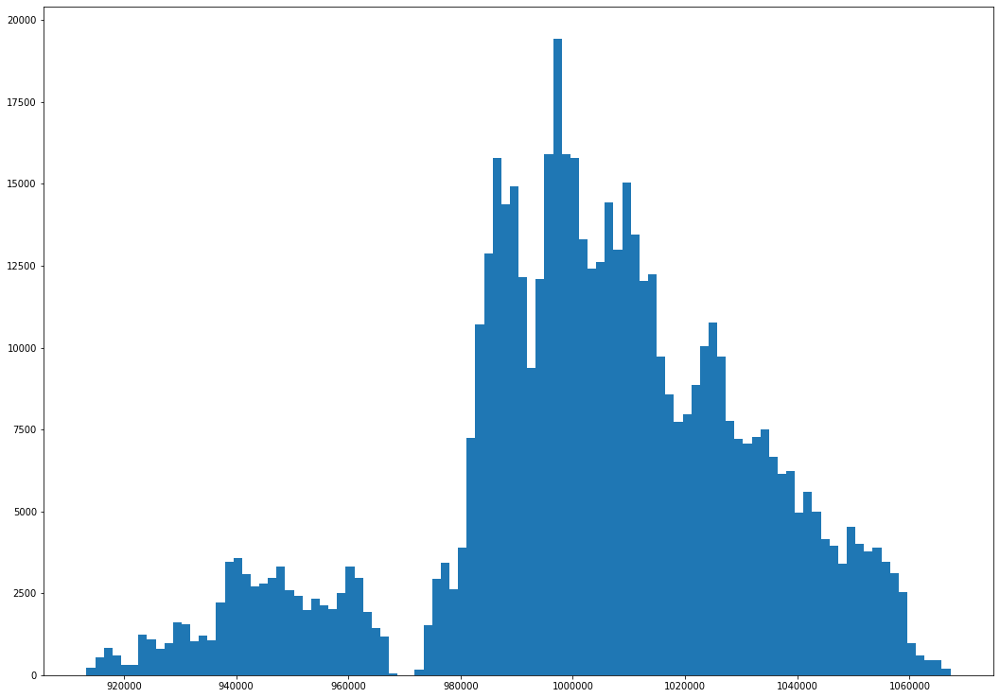

In [20]:
plt.figure(figsize=(18, 13))
plt.hist(df["X Coordinate (State Plane)"].values,bins=100)
plt.show()

(array([  286.,   566.,   540.,   645.,   476.,   619.,   741.,  1013.,
         1702.,  2123.,  1689.,  2101.,  2396.,  2107.,  2420.,  2243.,
         1183.,  1512.,  2545.,  3413.,  2640.,  4566.,  5297.,  5960.,
         6325.,  6761.,  7775.,  8798.,  9579.,  9563., 10490., 10989.,
        12651., 12841.,  9961.,  7942.,  5636.,  5788.,  6689.,  8368.,
         9392., 12758., 14974., 18191., 17324., 15030., 13209., 12674.,
        10505., 12371., 10556., 10248., 10224., 10300.,  9397.,  8509.,
         7721.,  6794.,  6886.,  8068.,  7241.,  7594.,  8475.,  8826.,
         7358.,  6133.,  4987.,  4758.,  3260.,  3141.,  2601.,  2332.,
         2197.,  2605.,  3218.,  3444.,  3848.,  3947.,  3766.,  4687.,
         4295.,  3638.,  3825.,  4354.,  3870.,  3486.,  2473.,  2217.,
         2514.,  2893.,  2930.,  2458.,  2351.,  2295.,  1766.,  1241.,
         1327.,  1150.,   549.,   241.]),
 array([121098.  , 122604.57, 124111.14, 125617.71, 127124.28, 128630.85,
        130137.42, 1

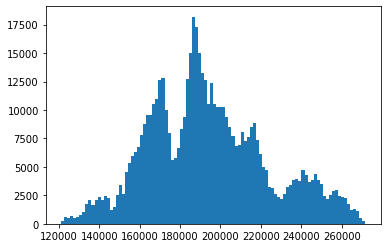

In [21]:
plt.hist(df["Y Coordinate (State Plane)"].values,bins=100)

### In contrast with Logitude & Latitude:

(array([2.2100e+02, 5.3600e+02, 8.2200e+02, 6.4400e+02, 2.7500e+02,
        3.2700e+02, 1.3070e+03, 1.0240e+03, 7.7200e+02, 1.0010e+03,
        1.6000e+03, 1.5870e+03, 1.0430e+03, 1.1830e+03, 1.1730e+03,
        2.3300e+03, 3.4240e+03, 3.5980e+03, 3.0910e+03, 2.6520e+03,
        2.9180e+03, 2.9180e+03, 3.2470e+03, 2.5710e+03, 2.4330e+03,
        1.9680e+03, 2.2840e+03, 2.1150e+03, 2.0390e+03, 2.5320e+03,
        3.4580e+03, 2.8560e+03, 1.8170e+03, 1.4410e+03, 1.0750e+03,
        3.0000e+01, 1.0000e+00, 0.0000e+00, 2.3700e+02, 1.7220e+03,
        2.9090e+03, 3.4790e+03, 2.5760e+03, 4.1630e+03, 7.4900e+03,
        1.1072e+04, 1.3116e+04, 1.5458e+04, 1.4682e+04, 1.4747e+04,
        1.1904e+04, 9.4160e+03, 1.2238e+04, 1.6380e+04, 1.9309e+04,
        1.5610e+04, 1.5783e+04, 1.2964e+04, 1.2521e+04, 1.2777e+04,
        1.4147e+04, 1.3110e+04, 1.5166e+04, 1.3264e+04, 1.1960e+04,
        1.2124e+04, 9.6790e+03, 8.5630e+03, 7.5830e+03, 7.9550e+03,
        8.8740e+03, 1.0060e+04, 1.0651e+04, 9.78

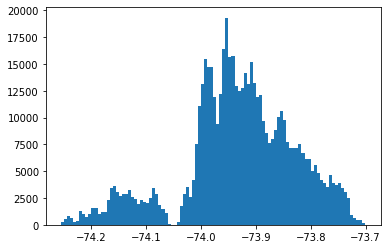

In [22]:
plt.hist(df["Longitude"].values,bins=100)

(array([  286.,   565.,   541.,   638.,   482.,   609.,   743.,   996.,
         1687.,  2126.,  1674.,  2114.,  2391.,  2074.,  2396.,  2290.,
         1212.,  1461.,  2463.,  3488.,  2569.,  4541.,  5300.,  5911.,
         6314.,  6788.,  7671.,  8716.,  9542.,  9590., 10459., 10935.,
        12660., 12856., 10091.,  8081.,  5667.,  5812.,  6617.,  8370.,
         9249., 12741., 15007., 18108., 17375., 15104., 13356., 12631.,
        10531., 12361., 10585., 10118., 10265., 10291.,  9481.,  8572.,
         7731.,  6781.,  6879.,  8059.,  7343.,  7513.,  8536.,  8747.,
         7414.,  6132.,  5000.,  4743.,  3314.,  3130.,  2592.,  2316.,
         2214.,  2552.,  3261.,  3422.,  3876.,  3951.,  3768.,  4688.,
         4317.,  3616.,  3953.,  4247.,  3850.,  3505.,  2472.,  2222.,
         2511.,  2903.,  2934.,  2460.,  2352.,  2295.,  1775.,  1221.,
         1325.,  1165.,   534.,   241.]),
 array([40.4988067 , 40.50294399, 40.50708128, 40.51121857, 40.51535586,
        40.51949315, 

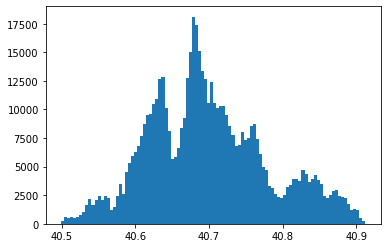

In [23]:
plt.hist(df["Latitude"].values,bins=100)

In [24]:
# Here based on results above we only keep X and Y coordinates:
for col in ["Longitude", "Latitude", "Location"]:
    df.drop(col, axis=1, inplace=True)

## Intuitively, from Data Dictionary, there are several clusters of geographic features:
### *Cluster 1: Incident Zip, Incident address, Street name, Cross Street 1, Cross Street 2, Intersection Street 1, Intersection Street 2 (string-format geographic information)
### *Cluster 2: X, Y, longitude, latitude, location (numeric geographic information)
### *Cluster 3: City, BBL, Borough, Community Board (catagorical geographic information)

### For now, I will just include numeric location information to indicate the geographic features of the dataset,  which means I will just leave out all features in cluster 1 because for now I have not come up with a good way  to deal with string-format geo info, and I think, intuitively, if we get correct numeric geo info, we can determine where the place is in the map, which is also one-to-one mapped to an address name including zip codes, street names and so on




In [25]:
df.drop(['Incident Zip', 'Incident Address', 'Street Name',
         'Cross Street 1', 'Cross Street 2', 'Intersection Street 1', 'Intersection Street 2'], axis=1, inplace=True)

In [26]:
df.head()

,Unique Key,Created Date,Closed Date,Agency Name,Complaint Type,Descriptor,Location Type,Address Type,Status,Resolution Description,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type,Park Facility Name
1,29655441,01/07/2015 08:17:00 AM,01/07/2015 12:00:00 PM,BCC - Queens East,Snow,15S Re-Plow/Spread/Ice-Snow Cond.,Street,INTERSECTION,Closed,The Department of Sanitation investigated this...,NaN,NaN,NaN,PHONE,Unspecified
2,29750581,01/19/2015 05:00:00 PM,01/21/2015 12:00:00 PM,BCC - Queens West,Litter Basket / Request,10 Litter Basket / Request,Sidewalk,INTERSECTION,Closed,The Department of Sanitation investigated this...,NaN,NaN,NaN,PHONE,Unspecified
3,29767423,01/22/2015 09:21:00 AM,01/31/2015 12:00:00 PM,A - Canine Task Force Citywide,Dirty Conditions,E8 Canine Violation,Sidewalk,BLOCKFACE,Closed,The Department of Sanitation investigated this...,NaN,NaN,NaN,ONLINE,Unspecified
4,29618799,01/02/2015 06:11:00 AM,01/05/2015 12:00:00 PM,Bronx 10,Sanitation Condition,12 Dead Animals,Sidewalk,NaN,Closed,The Department of Sanitation investigated this...,NaN,NaN,NaN,PHONE,Unspecified
5,29618633,01/02/2015 09:57:00 AM,01/05/2015 12:00:00 PM,Brooklyn North 03,Sweeping/Missed,3A Sweeping/Missed,Sidewalk,INTERSECTION,Closed,The Department of Sanitation has investigated ...,NaN,NaN,NaN,PHONE,Unspecified


## Complaint Type & Descriptor:

<BarContainer object of 23 artists>

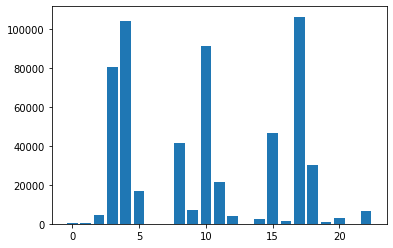

In [27]:
name, count = np.unique(df["Complaint Type"].values, return_counts = True)
plt.bar(np.arange(len(name)), count)

<BarContainer object of 62 artists>

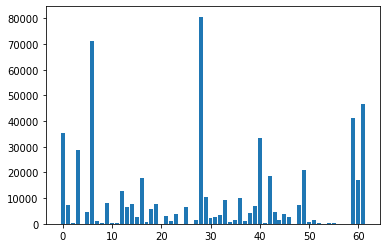

In [28]:
name, count = np.unique(df["Descriptor"].values, return_counts = True)
plt.bar(np.arange(len(name)), count)
# descriptor should be more spread and contain more information derived from Complaint Type, numerically and intuitively
# so we drop complaint type:

In [29]:
df.drop('Complaint Type', axis=1, inplace=True)

In [30]:
# Unique key makes no difference in our prediction modelling:
df.drop('Unique Key', axis=1, inplace=True)

In [31]:
df.drop('Park Facility Name', axis=1, inplace=True)

In [32]:
df.head()

,Created Date,Closed Date,Agency Name,Descriptor,Location Type,Address Type,Status,Resolution Description,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type
1,01/07/2015 08:17:00 AM,01/07/2015 12:00:00 PM,BCC - Queens East,15S Re-Plow/Spread/Ice-Snow Cond.,Street,INTERSECTION,Closed,The Department of Sanitation investigated this...,NaN,NaN,NaN,PHONE
2,01/19/2015 05:00:00 PM,01/21/2015 12:00:00 PM,BCC - Queens West,10 Litter Basket / Request,Sidewalk,INTERSECTION,Closed,The Department of Sanitation investigated this...,NaN,NaN,NaN,PHONE
3,01/22/2015 09:21:00 AM,01/31/2015 12:00:00 PM,A - Canine Task Force Citywide,E8 Canine Violation,Sidewalk,BLOCKFACE,Closed,The Department of Sanitation investigated this...,NaN,NaN,NaN,ONLINE
4,01/02/2015 06:11:00 AM,01/05/2015 12:00:00 PM,Bronx 10,12 Dead Animals,Sidewalk,NaN,Closed,The Department of Sanitation investigated this...,NaN,NaN,NaN,PHONE
5,01/02/2015 09:57:00 AM,01/05/2015 12:00:00 PM,Brooklyn North 03,3A Sweeping/Missed,Sidewalk,INTERSECTION,Closed,The Department of Sanitation has investigated ...,NaN,NaN,NaN,PHONE


In [33]:
np.unique(df['Resolution Description'].values.astype(str), return_counts = True)

(array(['Federal/State Asian Beetle quarantine area. Organic wood in this area must be chipped on-site by the Parks Dept. Please contact 3-1-1 to schedule an appointment.',
        'Property is fenced & locked - referred to Law Dept for access warrant',
        'Scheduled for lot cleaning. If access is gained, cleaning should be completed within 2 - 4 weeks.',
        'The Bicycle was found to be affixed to private property and therefore not eligible for removal by the City.',
        'The City has removed the graffiti from this property.',
        'The City inspected the property for cleaning, but no graffiti was found.',
        'The Departent of Sanitation found that this is not a vacant lot. There appears to be a business in operation at the location.',
        "The Departent of Sanitation has found that this property is part of the Parks Department's Green Thumb Program. Please call 311 to request maintenance.",
        'The Departent of Sanitation has found that this property is 

In [34]:
df = df[df['Status']=='Closed']
df.drop('Status', axis=1, inplace=True)
df.head()

,Created Date,Closed Date,Agency Name,Descriptor,Location Type,Address Type,Resolution Description,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type
1,01/07/2015 08:17:00 AM,01/07/2015 12:00:00 PM,BCC - Queens East,15S Re-Plow/Spread/Ice-Snow Cond.,Street,INTERSECTION,The Department of Sanitation investigated this...,NaN,NaN,NaN,PHONE
2,01/19/2015 05:00:00 PM,01/21/2015 12:00:00 PM,BCC - Queens West,10 Litter Basket / Request,Sidewalk,INTERSECTION,The Department of Sanitation investigated this...,NaN,NaN,NaN,PHONE
3,01/22/2015 09:21:00 AM,01/31/2015 12:00:00 PM,A - Canine Task Force Citywide,E8 Canine Violation,Sidewalk,BLOCKFACE,The Department of Sanitation investigated this...,NaN,NaN,NaN,ONLINE
4,01/02/2015 06:11:00 AM,01/05/2015 12:00:00 PM,Bronx 10,12 Dead Animals,Sidewalk,NaN,The Department of Sanitation investigated this...,NaN,NaN,NaN,PHONE
5,01/02/2015 09:57:00 AM,01/05/2015 12:00:00 PM,Brooklyn North 03,3A Sweeping/Missed,Sidewalk,INTERSECTION,The Department of Sanitation has investigated ...,NaN,NaN,NaN,PHONE


In [35]:
df.drop('Resolution Description', axis=1, inplace=True) # do not deal with text features for now

In [36]:
df.head()

,Created Date,Closed Date,Agency Name,Descriptor,Location Type,Address Type,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type
1,01/07/2015 08:17:00 AM,01/07/2015 12:00:00 PM,BCC - Queens East,15S Re-Plow/Spread/Ice-Snow Cond.,Street,INTERSECTION,NaN,NaN,NaN,PHONE
2,01/19/2015 05:00:00 PM,01/21/2015 12:00:00 PM,BCC - Queens West,10 Litter Basket / Request,Sidewalk,INTERSECTION,NaN,NaN,NaN,PHONE
3,01/22/2015 09:21:00 AM,01/31/2015 12:00:00 PM,A - Canine Task Force Citywide,E8 Canine Violation,Sidewalk,BLOCKFACE,NaN,NaN,NaN,ONLINE
4,01/02/2015 06:11:00 AM,01/05/2015 12:00:00 PM,Bronx 10,12 Dead Animals,Sidewalk,NaN,NaN,NaN,NaN,PHONE
5,01/02/2015 09:57:00 AM,01/05/2015 12:00:00 PM,Brooklyn North 03,3A Sweeping/Missed,Sidewalk,INTERSECTION,NaN,NaN,NaN,PHONE


In [37]:
df = df[~df.isnull().any(axis=1)] # remove rows with any feature = Nan

In [38]:
df.set_index('Created Date', inplace=True)
df

,Closed Date,Agency Name,Descriptor,Location Type,Address Type,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type
Created Date,,,,,,,,,
02/13/2016 12:00:00 PM,02/17/2016 12:00:00 PM,Department of Sanitation,Derelict Vehicles,Street,ADDRESS,2.056010e+09,1031816.0,236058.0,ONLINE
05/27/2016 12:00:00 PM,05/27/2016 12:00:00 PM,Department of Sanitation,Derelict Vehicles,Street,ADDRESS,3.052210e+09,996109.0,170992.0,MOBILE
10/17/2016 12:00:00 PM,10/18/2016 12:00:00 PM,Department of Sanitation,Derelict Vehicles,Street,ADDRESS,4.014030e+09,1018416.0,216108.0,PHONE
05/01/2017 12:00:00 PM,05/03/2017 12:00:00 PM,Department of Sanitation,Derelict Vehicles,Street,ADDRESS,5.080200e+09,916777.0,126973.0,ONLINE
05/15/2017 12:00:00 PM,05/17/2017 12:00:00 PM,Department of Sanitation,Derelict Vehicles,Street,ADDRESS,2.049530e+09,1031774.0,262407.0,ONLINE
...,...,...,...,...,...,...,...,...,...
12/29/2017 03:53:00 PM,01/03/2018 12:00:00 PM,BCC - Brooklyn North,E10 Street Obstruction,Sidewalk,ADDRESS,3.018930e+09,994193.0,192170.0,ONLINE
12/31/2017 12:08:00 PM,01/04/2018 12:00:00 PM,BCC - Brooklyn North,10 Litter Basket / Request,Sidewalk,ADDRESS,3.050838e+09,996430.0,177232.0,ONLINE
12/31/2015 10:28:00 AM,01/05/2016 12:00:00 PM,Queens East 12,1 Missed Collection,Sidewalk,ADDRESS,4.129970e+09,1050813.0,186273.0,PHONE


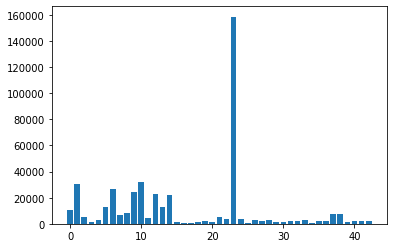

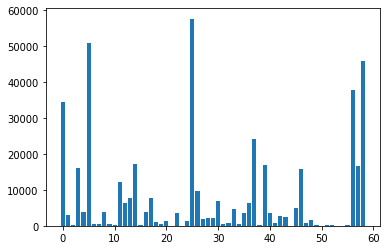

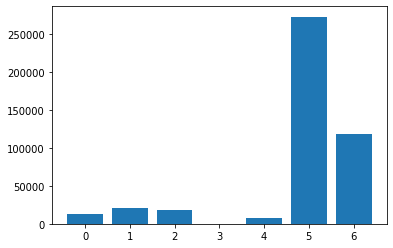

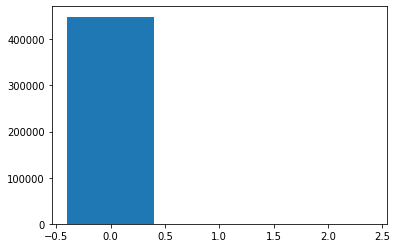

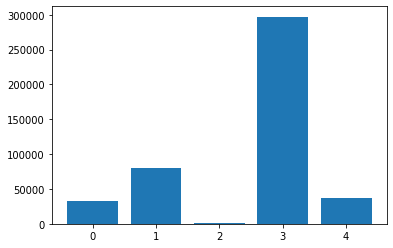

,Closed Date,Agency Name,Descriptor,Location Type,Address Type,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type
Created Date,,,,,,,,,
02/13/2016 12:00:00 PM,02/17/2016 12:00:00 PM,23.0,25.0,6.0,0.0,2.056010e+09,1031816.0,236058.0,1.0
05/27/2016 12:00:00 PM,05/27/2016 12:00:00 PM,23.0,25.0,6.0,0.0,3.052210e+09,996109.0,170992.0,0.0
10/17/2016 12:00:00 PM,10/18/2016 12:00:00 PM,23.0,25.0,6.0,0.0,4.014030e+09,1018416.0,216108.0,3.0
05/01/2017 12:00:00 PM,05/03/2017 12:00:00 PM,23.0,25.0,6.0,0.0,5.080200e+09,916777.0,126973.0,1.0
05/15/2017 12:00:00 PM,05/17/2017 12:00:00 PM,23.0,25.0,6.0,0.0,2.049530e+09,1031774.0,262407.0,1.0
...,...,...,...,...,...,...,...,...,...
12/29/2017 03:53:00 PM,01/03/2018 12:00:00 PM,9.0,28.0,5.0,0.0,3.018930e+09,994193.0,192170.0,1.0
12/31/2017 12:08:00 PM,01/04/2018 12:00:00 PM,9.0,1.0,5.0,0.0,3.050838e+09,996430.0,177232.0,1.0
12/31/2015 10:28:00 AM,01/05/2016 12:00:00 PM,38.0,0.0,5.0,0.0,4.129970e+09,1050813.0,186273.0,3.0


In [39]:
df = df[~df.isnull().any(axis=1)]
for col in ["Agency Name", "Descriptor", "Location Type", "Address Type", "Open Data Channel Type"]:
    enc = preprocessing.OrdinalEncoder()
    hhx = [[value] for value in df[col]]
    ct = enc.fit_transform(hhx)
    name, count = np.unique(ct.reshape(1, -1), return_counts = True)
    plt.bar(name, count)
    plt.show()
    hc = pd.Series(ct.reshape(1, -1)[0])
    hc.index = df.index
    df[col] = hc
df

In [40]:
df = df.reset_index()
df

,Created Date,Closed Date,Agency Name,Descriptor,Location Type,Address Type,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type
0,02/13/2016 12:00:00 PM,02/17/2016 12:00:00 PM,23.0,25.0,6.0,0.0,2.056010e+09,1031816.0,236058.0,1.0
1,05/27/2016 12:00:00 PM,05/27/2016 12:00:00 PM,23.0,25.0,6.0,0.0,3.052210e+09,996109.0,170992.0,0.0
2,10/17/2016 12:00:00 PM,10/18/2016 12:00:00 PM,23.0,25.0,6.0,0.0,4.014030e+09,1018416.0,216108.0,3.0
3,05/01/2017 12:00:00 PM,05/03/2017 12:00:00 PM,23.0,25.0,6.0,0.0,5.080200e+09,916777.0,126973.0,1.0
4,05/15/2017 12:00:00 PM,05/17/2017 12:00:00 PM,23.0,25.0,6.0,0.0,2.049530e+09,1031774.0,262407.0,1.0
...,...,...,...,...,...,...,...,...,...,...
448964,12/29/2017 03:53:00 PM,01/03/2018 12:00:00 PM,9.0,28.0,5.0,0.0,3.018930e+09,994193.0,192170.0,1.0
448965,12/31/2017 12:08:00 PM,01/04/2018 12:00:00 PM,9.0,1.0,5.0,0.0,3.050838e+09,996430.0,177232.0,1.0
448966,12/31/2015 10:28:00 AM,01/05/2016 12:00:00 PM,38.0,0.0,5.0,0.0,4.129970e+09,1050813.0,186273.0,3.0
448967,12/31/2015 03:13:00 PM,01/06/2016 12:00:00 PM,6.0,39.0,1.0,0.0,4.086370e+09,1061721.0,204857.0,1.0


In [41]:
#df["Created Date"] = pd.Series(df["Created Date"]).apply(lambda x: datetime.strptime(x, "%m/%d/%Y %H:%M:%S %p"))
df["Created Date"] = pd.Series(df["Created Date"]).apply(lambda x: datetime.strptime(x, "%m/%d/%Y %H:%M:%S %p"))
df

,Created Date,Closed Date,Agency Name,Descriptor,Location Type,Address Type,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type
0,2016-02-13 12:00:00,02/17/2016 12:00:00 PM,23.0,25.0,6.0,0.0,2.056010e+09,1031816.0,236058.0,1.0
1,2016-05-27 12:00:00,05/27/2016 12:00:00 PM,23.0,25.0,6.0,0.0,3.052210e+09,996109.0,170992.0,0.0
2,2016-10-17 12:00:00,10/18/2016 12:00:00 PM,23.0,25.0,6.0,0.0,4.014030e+09,1018416.0,216108.0,3.0
3,2017-05-01 12:00:00,05/03/2017 12:00:00 PM,23.0,25.0,6.0,0.0,5.080200e+09,916777.0,126973.0,1.0
4,2017-05-15 12:00:00,05/17/2017 12:00:00 PM,23.0,25.0,6.0,0.0,2.049530e+09,1031774.0,262407.0,1.0
...,...,...,...,...,...,...,...,...,...,...
448964,2017-12-29 03:53:00,01/03/2018 12:00:00 PM,9.0,28.0,5.0,0.0,3.018930e+09,994193.0,192170.0,1.0
448965,2017-12-31 12:08:00,01/04/2018 12:00:00 PM,9.0,1.0,5.0,0.0,3.050838e+09,996430.0,177232.0,1.0
448966,2015-12-31 10:28:00,01/05/2016 12:00:00 PM,38.0,0.0,5.0,0.0,4.129970e+09,1050813.0,186273.0,3.0
448967,2015-12-31 03:13:00,01/06/2016 12:00:00 PM,6.0,39.0,1.0,0.0,4.086370e+09,1061721.0,204857.0,1.0


In [42]:
df["Closed Date"] = pd.Series(df["Closed Date"]).apply(lambda x: datetime.strptime(x, "%m/%d/%Y %H:%M:%S %p"))
df['Closed Date'] = df['Closed Date']-df["Created Date"]

In [43]:
df

,Created Date,Closed Date,Agency Name,Descriptor,Location Type,Address Type,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type
0,2016-02-13 12:00:00,4 days 00:00:00,23.0,25.0,6.0,0.0,2.056010e+09,1031816.0,236058.0,1.0
1,2016-05-27 12:00:00,0 days 00:00:00,23.0,25.0,6.0,0.0,3.052210e+09,996109.0,170992.0,0.0
2,2016-10-17 12:00:00,1 days 00:00:00,23.0,25.0,6.0,0.0,4.014030e+09,1018416.0,216108.0,3.0
3,2017-05-01 12:00:00,2 days 00:00:00,23.0,25.0,6.0,0.0,5.080200e+09,916777.0,126973.0,1.0
4,2017-05-15 12:00:00,2 days 00:00:00,23.0,25.0,6.0,0.0,2.049530e+09,1031774.0,262407.0,1.0
...,...,...,...,...,...,...,...,...,...,...
448964,2017-12-29 03:53:00,5 days 08:07:00,9.0,28.0,5.0,0.0,3.018930e+09,994193.0,192170.0,1.0
448965,2017-12-31 12:08:00,3 days 23:52:00,9.0,1.0,5.0,0.0,3.050838e+09,996430.0,177232.0,1.0
448966,2015-12-31 10:28:00,5 days 01:32:00,38.0,0.0,5.0,0.0,4.129970e+09,1050813.0,186273.0,3.0
448967,2015-12-31 03:13:00,6 days 08:47:00,6.0,39.0,1.0,0.0,4.086370e+09,1061721.0,204857.0,1.0


In [44]:
df['Closed Date'] = df['Closed Date'].apply(lambda x: x.total_seconds())

In [45]:
df = df[df['Closed Date']>0]
df

,Created Date,Closed Date,Agency Name,Descriptor,Location Type,Address Type,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type
0,2016-02-13 12:00:00,345600.0,23.0,25.0,6.0,0.0,2.056010e+09,1031816.0,236058.0,1.0
2,2016-10-17 12:00:00,86400.0,23.0,25.0,6.0,0.0,4.014030e+09,1018416.0,216108.0,3.0
3,2017-05-01 12:00:00,172800.0,23.0,25.0,6.0,0.0,5.080200e+09,916777.0,126973.0,1.0
4,2017-05-15 12:00:00,172800.0,23.0,25.0,6.0,0.0,2.049530e+09,1031774.0,262407.0,1.0
5,2017-07-31 12:00:00,86400.0,23.0,25.0,6.0,0.0,3.034380e+09,1008981.0,188561.0,0.0
...,...,...,...,...,...,...,...,...,...,...
448964,2017-12-29 03:53:00,461220.0,9.0,28.0,5.0,0.0,3.018930e+09,994193.0,192170.0,1.0
448965,2017-12-31 12:08:00,345120.0,9.0,1.0,5.0,0.0,3.050838e+09,996430.0,177232.0,1.0
448966,2015-12-31 10:28:00,437520.0,38.0,0.0,5.0,0.0,4.129970e+09,1050813.0,186273.0,3.0
448967,2015-12-31 03:13:00,550020.0,6.0,39.0,1.0,0.0,4.086370e+09,1061721.0,204857.0,1.0


In [46]:
df['year'] = pd.DatetimeIndex(df['Created Date']).year
df['month'] = pd.DatetimeIndex(df['Created Date']).month
df['day'] = pd.DatetimeIndex(df['Created Date']).day
df['dayofyear'] = pd.DatetimeIndex(df['Created Date']).dayofyear
df['weekofyear'] = pd.DatetimeIndex(df['Created Date']).weekofyear
df['weekday'] = pd.DatetimeIndex(df['Created Date']).weekday
df['quarter'] = pd.DatetimeIndex(df['Created Date']).quarter
df['is_month_start'] = pd.DatetimeIndex(df['Created Date']).is_month_start
df['is_month_end'] = pd.DatetimeIndex(df['Created Date']).is_month_end

df # Here, in the future, we can do more such as including festival checking.

/Users/huhanxu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/Users/huhanxu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/Users/huhanxu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value

,Created Date,Closed Date,Agency Name,Descriptor,Location Type,Address Type,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type,year,month,day,dayofyear,weekofyear,weekday,quarter,is_month_start,is_month_end
0,2016-02-13 12:00:00,345600.0,23.0,25.0,6.0,0.0,2.056010e+09,1031816.0,236058.0,1.0,2016,2,13,44,6,5,1,False,False
2,2016-10-17 12:00:00,86400.0,23.0,25.0,6.0,0.0,4.014030e+09,1018416.0,216108.0,3.0,2016,10,17,291,42,0,4,False,False
3,2017-05-01 12:00:00,172800.0,23.0,25.0,6.0,0.0,5.080200e+09,916777.0,126973.0,1.0,2017,5,1,121,18,0,2,True,False
4,2017-05-15 12:00:00,172800.0,23.0,25.0,6.0,0.0,2.049530e+09,1031774.0,262407.0,1.0,2017,5,15,135,20,0,2,False,False
5,2017-07-31 12:00:00,86400.0,23.0,25.0,6.0,0.0,3.034380e+09,1008981.0,188561.0,0.0,2017,7,31,212,31,0,3,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
448964,2017-12-29 03:53:00,461220.0,9.0,28.0,5.0,0.0,3.018930e+09,994193.0,192170.0,1.0,2017,12,29,363,52,4,4,False,False
448965,2017-12-31 12:08:00,345120.0,9.0,1.0,5.0,0.0,3.050838e+09,996430.0,177232.0,1.0,2017,12,31,365,52,6,4,False,True
448966,2015-12-31 10:28:00,437520.0,38.0,0.0,5.0,0.0,4.129970e+09,1050813.0,186273.0,3.0,2015,12,31,365,53,3,4,False,True
448967,2015-12-31 03:13:00,550020.0,6.0,39.0,1.0,0.0,4.086370e+09,1061721.0,204857.0,1.0,2015,12,31,365,53,3,4,False,True


In [47]:
df.drop('Created Date', axis=1, inplace=True)

y = df["Closed Date"]

df.drop('Closed Date', axis=1, inplace=True)

y

/Users/huhanxu/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


0         345600.0
2          86400.0
3         172800.0
4         172800.0
5          86400.0
            ...   
448964    461220.0
448965    345120.0
448966    437520.0
448967    550020.0
448968      9480.0
Name: Closed Date, Length: 418126, dtype: float64

In [48]:
df["is_month_start"] = df["is_month_start"].apply(lambda x: int(x))
df["is_month_end"] = df["is_month_end"].apply(lambda x: int(x))
df

/Users/huhanxu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/Users/huhanxu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Agency Name,Descriptor,Location Type,Address Type,BBL,X Coordinate (State Plane),Y Coordinate (State Plane),Open Data Channel Type,year,month,day,dayofyear,weekofyear,weekday,quarter,is_month_start,is_month_end
0,23.0,25.0,6.0,0.0,2.056010e+09,1031816.0,236058.0,1.0,2016,2,13,44,6,5,1,0,0
2,23.0,25.0,6.0,0.0,4.014030e+09,1018416.0,216108.0,3.0,2016,10,17,291,42,0,4,0,0
3,23.0,25.0,6.0,0.0,5.080200e+09,916777.0,126973.0,1.0,2017,5,1,121,18,0,2,1,0
4,23.0,25.0,6.0,0.0,2.049530e+09,1031774.0,262407.0,1.0,2017,5,15,135,20,0,2,0,0
5,23.0,25.0,6.0,0.0,3.034380e+09,1008981.0,188561.0,0.0,2017,7,31,212,31,0,3,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
448964,9.0,28.0,5.0,0.0,3.018930e+09,994193.0,192170.0,1.0,2017,12,29,363,52,4,4,0,0
448965,9.0,1.0,5.0,0.0,3.050838e+09,996430.0,177232.0,1.0,2017,12,31,365,52,6,4,0,1
448966,38.0,0.0,5.0,0.0,4.129970e+09,1050813.0,186273.0,3.0,2015,12,31,365,53,3,4,0,1
448967,6.0,39.0,1.0,0.0,4.086370e+09,1061721.0,204857.0,1.0,2015,12,31,365,53,3,4,0,1


# Prediction: 
### Linear Regression， Random Forest, XGBoost

In [49]:
# Training-Test set split:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(df, y, test_size=0.20, random_state=42)

In [50]:
# Preprocessing: StandardScalar
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaled_train = scaler.fit_transform(X_train)
scaled_test = scaler.fit_transform(X_test)

In [54]:
from sklearn import model_selection
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV
from math import sqrt

### Linear Regression:

In [52]:
model_reg = LinearRegression().fit(scaled_train, y_train)
pred_train_rf= model_reg.predict(scaled_train)
print(np.sqrt(mean_squared_error(y_train,pred_train_rf)))
print(r2_score(y_train, pred_train_rf))

pred_test_rf = model_reg.predict(scaled_test)
print(np.sqrt(mean_squared_error(y_test,pred_test_rf)))
print(r2_score(y_test, pred_test_rf))

# Poor performance with Linear Regression model

10742102.108144095
0.03571228968361506
9651171.161032038
0.04180448525264602


### Random Forest:

In [ ]:
model_rf = RandomForestRegressor(n_estimators=100, oob_score=True, random_state=100, max_depth=30)
model_rf.fit(scaled_train, y_train) 
pred_train_rf= model_rf.predict(scaled_train)
print(np.sqrt(mean_squared_error(y_train,pred_train_rf)))
print(r2_score(y_train, pred_train_rf))

pred_test_rf = model_rf.predict(scaled_test)
print(np.sqrt(mean_squared_error(y_test, pred_test_rf)))
print(r2_score(y_test, pred_test_rf))

# Random initialisation of hyper-parameters, which need to be tuned in the following codes:

In [55]:
# Create the parameter grid based on the results of random search 
param_grid = {
    'bootstrap': [True],
    'max_depth': [50, 80, 90, 100],
    'max_features': [2, 3, 5],
    'min_samples_leaf': [3, 5, 10],
    'n_estimators': [50, 100, 200, 300, 500]
}
# Create a based model
rf = RandomForestRegressor()
# Instantiate the grid search model
grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, 
                          cv = 3, n_jobs = 8, verbose = 2)

grid_search.fit(scaled_train, y_train)
grid_search.best_params_

Fitting 3 folds for each of 180 candidates, totalling 540 fits


[Parallel(n_jobs=8)]: Using backend LokyBackend with 8 concurrent workers.


KeyboardInterrupt: 

### XGBoost:

In [55]:
import xgboost

param_grid = {
    'max_depth': [20, 50],
    'subsample': [0.2, 0.7],
    'colsample_bytree': [0.5, 1],
    'n_estimators': [50, 200, 500]
}
# Create a based model
model = xgboost.XGBRegressor()
# Instantiate the grid search model
grid_search = GridSearchCV(estimator = model, param_grid = param_grid, 
                          cv = 3, n_jobs = 8, verbose = 2)

grid_search.fit(scaled_train, y_train)
grid_search.best_params_

Fitting 3 folds for each of 24 candidates, totalling 72 fits


[Parallel(n_jobs=8)]: Using backend LokyBackend with 8 concurrent workers.


KeyboardInterrupt: 

# Visualisation

In [78]:
import plotly.express as px
import folium
from folium.plugins import HeatMap

df1 = pd.read_csv("311-DSNY-20151017.csv")

In [79]:
gb_df = df1.groupby(['Latitude', 'Longitude']).count()
gb_df = gb_df.iloc[:, 0]
hhx_df = pd.DataFrame(gb_df).reset_index()

In [82]:
calls_map = folium.Map(location=[40.742459, -73.971765], zoom_start=20)
#data = [[x[0], x[1], 1] for x in np.array(bars[['Latitude', 'Longitude']])]
HeatMap(hhx_df, radius = 20).add_to(calls_map)
pubs_map